# MELTS geobarometry part 1 - quartz - 2-feldspar saturated rhyolites

- The position of the quartz - 2-feldspar eutectic in high-silca rhyolitic magmas is sensitive to pressure (and possibly other variables; fO$_2$, H$_2$O, CO$_2$).
- If MELTS accurately recreates phase stability (and the sensitivity to the relevant parameters), it could be used as a barometer in igneous systems by searching for the pressure at which the mineral saturation curves intersect.

**Before any calculations can be run** users need to download the alphaMELTS for MATLAB files. Please see the installation guide on ReadTheDocs.

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import PetThermoTools as ptt

# If the alphaMELTS for Python files have not been added to your Python path (see installation guide) then use the two lines below to add
# the location of the alphaMELTS files here.
# import sys
# sys.path.append(r'MELTS')

In [2]:
# used to suppress MELTS outputs in MacOS systems (run twice)
"""
import sys
import os
sys.stdout = open(os.devnull, 'w')
sys.stderr = open(os.devnull, 'w')
"""

"\nimport sys\nimport os\nsys.stdout = open(os.devnull, 'w')\nsys.stderr = open(os.devnull, 'w')\n"

To demonstrate how PetThermoTools can be used to evaluate the pressure of magma storage we will use the composition of a quartz-hosted melt inclusion from Anderson et al. (2000) to evaluate the method:

In [3]:
bulk = {'SiO2_Liq': 77.6,
       'TiO2_Liq': 0.09,
       'Al2O3_Liq': 12.3,
       'FeOt_Liq': 0.65,
       'MgO_Liq': 0.02,
       'CaO_Liq': 0.41,
       'Na2O_Liq': 4.49,
       'K2O_Liq': 4.69}

In this case, we evaluate the saturation temperature of quartz, plagioclase, and k-feldspar at 32 pressures between 250 and 5000 bars. The model runs an equilibrium crystallisation calculation at each pressure (these calculations are run in parallel),with the calculations starting at the liquidus and continuing until either: (i) all three phases are saturated; or (ii) the temperature is more than 25$^o$C below the liquidus (T_maxdrop_C).

The function will then calculate the maximum temperature separating the saturation of the 3 phases and use a spline fit to determine the pressure of the minimum offset. This pressure is then taken forward as the pressure of storage/extraction.

In [4]:
P_bar = np.linspace(250, 5000, 32)
phases = ['quartz1', 'plagioclase1', 'alkali-feldspar1']
Results = ptt.find_mineral_cosaturation(bulk = bulk, 
                                   Model = "MELTSv1.0.2",
                                   phases = phases,
                                   P_bar = P_bar, 
                                   T_initial_C = 900,
                                   H2O_Sat = True,
                                   find_min = True,
                                   fO2_buffer = "NNO")


alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system 

Processed line... suppress: rutile Processed line... suppress: tridymite Processed line... log fo2 path: nno ...Checking saturation state of potential solids.
...Adding the solid phase fluid to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =       4.78531, sNorm =       4.28577
...-->Linear search: Min =       -828518, step =       0.22115
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   2.09407e-08, sNorm =         1.206
...-->Linear search: Min =       -828518, step =         0.975
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   5.24764e-10, sNorm =         1.206
...-->Linear search: Min =       -828518, step =          1.25
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.30084e-10, sNorm =         1.206
...-->Linear search: Min =       -828518, step =      0.973985
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   2.56437e-

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturat

...-->Solving quadratic minimization Iter: 7.
...-->rNorm =    0.00277575, sNorm =       1.22319
...-->Linear search: Min =       -816696, step =    0.00012207
...Dropping phase plagioclase from the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   3.75683e-09, sNorm =       1.17138
...-->Linear search: Min =       -797406, step =           1.1
<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   2.24124e-10, sNorm =       1.18991
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Linear search: Min =       -801700, step =      0.965179
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   4.89554e-05, sNorm =       1.22163
...-->Linear search: Min =       -816696, step =       0.99981
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   2.57778e-08, sNorm =       1.21355
...-->Line

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of th

...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   2.57295e-07, sNorm =       1.11312
...-->Linear search: Min =       -796302, step =         0.975
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   6.46931e-09, sNorm =       1.11312
...-->Linear search: Min =       -796302, step =             1
...-->Solving quadratic minimization Iter: 43.
...-->rNorm =    1.8376e-10, sNorm =       1.06797
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   4.37666e-11, sNorm =       1.11312
...-->Linear search: Min =       -796302, step =      0.939844
...-->Linear search: Min =       -791674, step =          1.25
...-->Solving quadratic minimization Iter: 7.
...-->rNorm =   1.94689e-10, sNorm =       1.11312
...-->Linear search: Min =       -796302, step =        0.9375
...-->Solving quadratic minimization Iter: 8.
...-->rNorm =   4.96458e-11, sNorm =       1.11312
...-->Linear search: Min =       -796302, step =             1
...-->Solving quadratic minimization It


alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2


alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system 

Processed line... suppress: rutile Processed line... suppress: tridymite Processed line... log fo2 path: nno Processed line... suppress: rutile Processed line... suppress: tridymite Processed line... log fo2 path: nno ...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Adding the solid phase fluid to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =       2.93338, sNorm =       2.54776
...-->Linear search: Min =       -819473, step =      0.316222
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.25766e-07, sNorm =       1.16852
...-->Linear search: Min =       -819473, step =       1.09167
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.15266e-08, sNorm =       1.16852
...-->Linear search: Min =       -819473, step =         1.175
...Adding the solid phase fluid to the assemblage.
...Projecting equalit

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potentia

...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   2.29054e-08, sNorm =       1.16052
...-->Linear search: Min =       -806406, step =             1
...Checking saturation state of potential solids.
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   1.19939e-12, sNorm =       1.16751
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...-->Solving quadratic minimization Iter: 35.
...-->rNorm =   1.90914e-11, sNorm =       1.14155
...-->Linear search: Min =       -779280, step =         0.975
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.75394e-12, sNorm =       1.16052
<> Stable liquid solid assemblage achieved.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...Checking saturation state of potential sol

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid

 step =         0.975
...-->Solving quadratic minimization Iter: 85.
...-->Solving quadratic minimization Iter: 9.
...-->rNorm =   1.04952e-10, sNorm =       1.11075
...-->rNorm =   6.04145e-11, sNorm =       1.10145
...-->Linear search: Min =       -781751, step =             1
...-->Linear search: Min =       -780458, step =       1.08693
...-->Solving quadratic minimization Iter: 18.
...-->rNorm =   8.45961e-12, sNorm =       1.13847
...-->Linear search: Min =       -778417, step =           1.1
...-->Solving quadratic minimization Iter: 19.
...-->Solving quadratic minimization Iter: 92.
...-->rNorm =             0, sNorm =       1.13633
...-->rNorm =   6.98914e-11, sNorm =       1.11059
...-->Linear search: Min =       -779179, step =           1.1
...-->Solving quadratic minimization Iter: 54.
...-->rNorm =   8.40016e-12, sNorm =       1.14802
...-->Linear search: Min =       -780454, step =           1.1
...-->Solving quadratic minimization Iter: 21.
...-->rNorm =   2.23021e-10, 

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
['alkali-feldspar1', 'quartz1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded i

...-->Solving quadratic minimization Iter: 22.
...-->rNorm =   2.98648e-10, sNorm =       0.92037
...-->Solving quadratic minimization Iter: 19.
...-->rNorm =   2.59559e-11, sNorm =       1.09099
...-->Linear search: Min =       -775444, step =             1
...-->Solving quadratic minimization Iter: 8.
...-->rNorm =   7.20058e-12, sNorm =       1.07747
...Checking saturation state of potential solids.
...-->Linear search: Min =       -777703, step =        1.1125
...-->Linear search: Min =       -778337, step =           1.1
...-->Solving quadratic minimization Iter: 43.
...-->rNorm =   2.65669e-12, sNorm =       1.09894
...-->Linear search: Min =       -773091, step =      0.966406
...-->Solving quadratic minimization Iter: 23.
...-->rNorm =   8.06543e-11, sNorm =       0.92037
...-->Linear search: Min =       -778337, step =             1
...-->Solving quadratic minimization Iter: 20.
...-->rNorm =   3.86753e-11, sNorm =       1.09099
...-->Linear search: Min =       -775444, step =

Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
['alkali-feldspar1', 'quartz1', 'leucite1', 'rhm-oxide1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'rhm-oxide1', 'fluid1']
...Checkin

...-->Linear search: Min =       -772799, step =           1.1
...-->Solving quadratic minimization Iter: 76.
...-->rNorm =   2.74432e-11, sNorm =      0.898398
...-->Solving quadratic minimization Iter: 49.
...-->rNorm =    4.0433e-11, sNorm =       1.03491
...-->Linear search: Min =       -772621, step =       1.09777
...-->Linear search: Min =       -774204, step =             1
...-->Solving quadratic minimization Iter: 74.
...-->rNorm =   1.73163e-10, sNorm =      0.902975
...-->Solving quadratic minimization Iter: 50.
...-->rNorm =   4.00916e-11, sNorm =       1.03491
...-->Linear search: Min =       -772621, step =         0.975
...-->Solving quadratic minimization Iter: 77.
...-->Linear search: Min =       -772799, step =             1
...-->rNorm =   7.70169e-11, sNorm =      0.898398
...-->Linear search: Min =       -774204, step =         0.975
...-->Solving quadratic minimization Iter: 51.
...-->rNorm =    7.2518e-12, sNorm =       1.03491
...-->Linear search: Min =       -

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'leucite1', 'spinel1', 'rhm-oxide1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'leucite1', 'spinel1', 'rhm-oxide1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', '

Processed line... suppress: rutile Processed line... suppress: tridymite Processed line... log fo2 path: nno ...Checking saturation state of potential solids.
...Adding the solid phase fluid to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =        1.5143, sNorm =       1.42548
...-->Linear search: Min =       -806863, step =       0.47495
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   3.48518e-08, sNorm =       1.13762
...-->Linear search: Min =       -806863, step =       1.09777
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   3.40232e-09, sNorm =       1.13762
...-->Linear search: Min =       -806863, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =             0, sNorm =       1.13762
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...M

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Cu

...-->Solving quadratic minimization Iter: 10.
...-->Linear search: Min =       -770951, step =          1.05
...-->rNorm =   1.36525e-11, sNorm =        1.1316
...-->Linear search: Min =       -772171, step =         0.975
...-->Solving quadratic minimization Iter: 13.
...-->rNorm =   1.17563e-11, sNorm =       1.13871
...-->Linear search: Min =       -771758, step =       1.14375
...-->Solving quadratic minimization Iter: 27.
...-->rNorm =    7.0115e-12, sNorm =       1.13065
...-->Linear search: Min =       -772949, step =      0.974665
...-->Solving quadratic minimization Iter: 41.
...-->rNorm =   8.77658e-12, sNorm =       1.13406
...-->Linear search: Min =       -775476, step =             1
...-->Solving quadratic minimization Iter: 14.
...-->rNorm =   6.67024e-12, sNorm =       1.11465
...-->Linear search: Min =       -773217, step =             1
...-->Solving quadratic minimization Iter: 11.
...-->rNorm =   1.32218e-11, sNorm =        1.1316
...-->Linear search: Min =       -

Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt fil

...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   3.73826e-06, sNorm =       1.09362
...-->Solving quadratic minimization Iter: 9.
...-->rNorm =   2.78142e-11, sNorm =       1.09383
...-->Linear search: Min =       -767497, step =             1
...-->Linear search: Min =       -770767, step =           1.1
...Adding the solid phase alkali-feldspar to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 10.
...-->rNorm =   7.45716e-12, sNorm =       1.09383
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   3.73801e-07, sNorm =       1.09362
...-->Linear search: Min =       -770767, step =             1
...-->Linear search: Min =       -767497, step =      0.976562
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =     0.0235195, sNorm =       1.06961
...-->Solving quadratic minimization Iter: 

['quartz1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
['alkali-feldspar1', 'quartz1', 'fluid1']
['quartz1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking 

To evaluate these results we can do a few different things.

First, we can use a series of in-built plotting functions to visualise the results. For example, we can view the saturation surfaces of the three phases against pressure.

(<Figure size 500x400 with 1 Axes>,
 <Axes: xlabel='P (bars)', ylabel='T ($\\degree$C)'>)

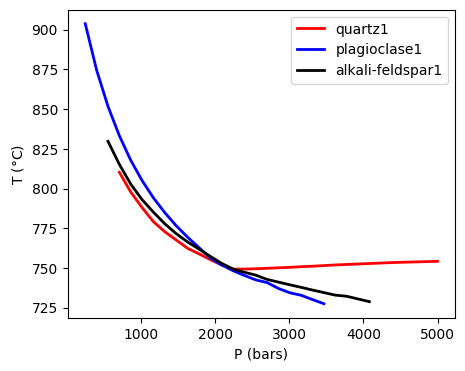

In [5]:
ptt.plot_surfaces(Results = Results, P_bar = P_bar, phases = phases)

Alternatively we can examine the residual temperatures and how these vary with pressure (along with the spline fit).

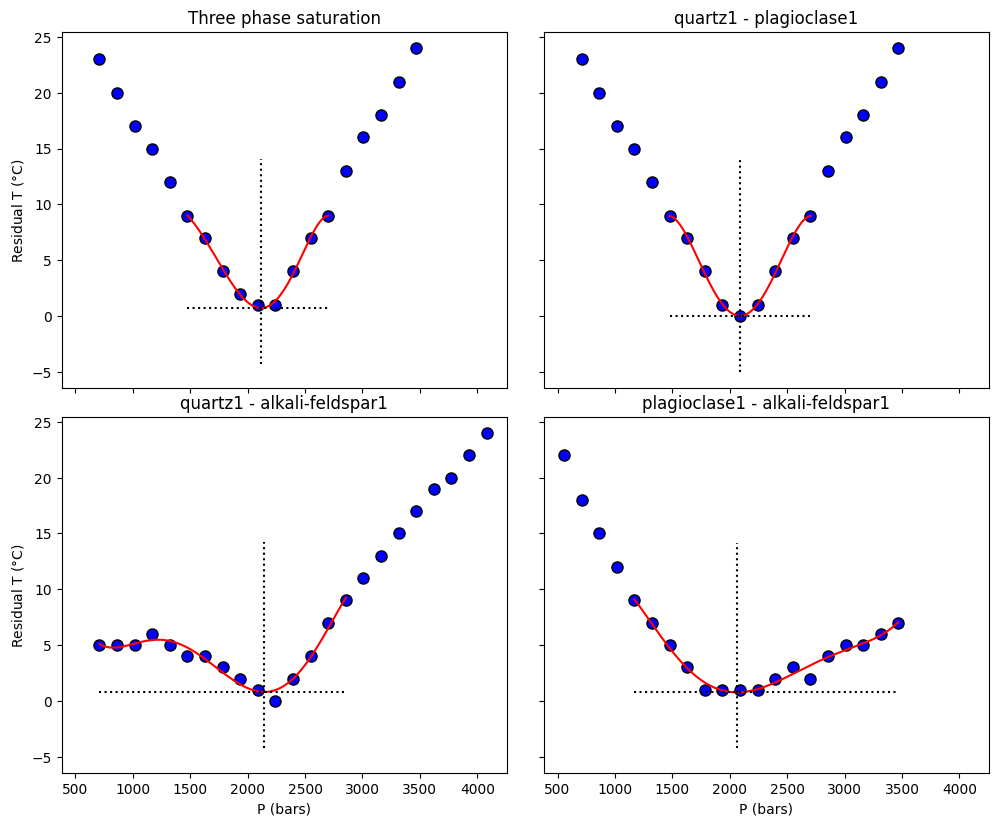

In [6]:
ptt.residualT_plot(Results = Results, P_bar = P_bar, phases = phases)

Alternatively, we can extract the pressure of magma storage directly from the 'Results' output variable. Doing so reveals that 'Results' contains a variety of information. First, it contains arrays for the saturation temperature of the three phases (at each pressure). Second, the liquidus temperature and the melt H$_2$O content at the liquidus is also included. Third, the temperature residuals between the saturation points of the different phases are also stored in this output. Finally, if 'find_min = True' has been selected in the initial function, the 'Results' variable will also contain the minimum pressure determined by the spline-fit to the data.

In [7]:
Results.keys()

dict_keys(['quartz1', 'plagioclase1', 'alkali-feldspar1', 'T_Liq', 'H2O_melt', '3 Phase Saturation', 'quartz1 - plagioclase1', 'quartz1 - alkali-feldspar1', 'plagioclase1 - alkali-feldspar1', 'CurveMin'])

Examine the quartz saturation temperature (pressure is given by the variable P_bar):

In [8]:
Results['quartz1']

array([[[  nan,   nan,   nan, 810.2, 797.8, 788. , 779.1, 772.8, 767.6,
         762.4, 758.9, 755.3, 751.9, 749.3, 749.3, 749.5, 749.8, 750.1,
         750.4, 750.8, 751.1, 751.5, 751.9, 752.2, 752.5, 752.8, 753.1,
         753.4, 753.6, 753.8, 754. , 754.2]]])

Examine the temperature residual between quartz and plagioclase saturation:

In [9]:
Results['quartz1 - plagioclase1']

array([[[nan, nan, nan, 23., 20., 17., 15., 12.,  9.,  7.,  4.,  1.,
          0.,  1.,  4.,  7.,  9., 13., 16., 18., 21., 24., nan, nan,
         nan, nan, nan, nan, nan, nan, nan, nan]]])

In [10]:
print('Pressure of minimum residual: ' + str(round(Results['CurveMin']['3 Phase Saturation']['P_min'],2)) + ' bars')
print('Minimum temperature residual: ' + str(round(Results['CurveMin']['3 Phase Saturation']['Res_min'], 2)) + ' $^o$C')

Pressure of minimum residual: 2116.43 bars
Minimum temperature residual: 0.72 $^o$C


## How does parallel processing affect calculation speeds?

Here we run the same calculations but investigate how parallel processing might influence the speed of the calculations by running the calculation first with only 1 process in parallel, then increasing this number to 2, 4, and 8.

In [11]:
"""
import time
import multiprocessing

P_bar = np.linspace(250, 5000, 32)
phases = ['quartz1', 'plagioclase1', 'alkali-feldspar1']

c = np.array([1,2,4,8,16,32])
t = np.zeros(len(c))
for i in range(len(c)):
    if c[i] > multiprocessing.cpu_count():
        t[i] = np.nan
    else:
        Start = time.time()
        Results = ptt.find_mineral_cosaturation(bulk = bulk, 
                                        cores = c[i],
                                        Model = "MELTSv1.0.2",
                                        phases = phases,
                                        P_bar = P_bar, 
                                        T_initial_C = 900,
                                        H2O_Sat = True,
                                        find_min = True,
                                        fO2_buffer = "NNO")
        t[i] = time.time() - Start
"""       

'\nimport time\nimport multiprocessing\n\nP_bar = np.linspace(250, 5000, 32)\nphases = [\'quartz1\', \'plagioclase1\', \'alkali-feldspar1\']\n\nc = np.array([1,2,4,8,16,32])\nt = np.zeros(len(c))\nfor i in range(len(c)):\n    if c[i] > multiprocessing.cpu_count():\n        t[i] = np.nan\n    else:\n        Start = time.time()\n        Results = ptt.find_mineral_cosaturation(bulk = bulk, \n                                        cores = c[i],\n                                        Model = "MELTSv1.0.2",\n                                        phases = phases,\n                                        P_bar = P_bar, \n                                        T_initial_C = 900,\n                                        H2O_Sat = True,\n                                        find_min = True,\n                                        fO2_buffer = "NNO")\n        t[i] = time.time() - Start\n'

In [12]:
P_bar = np.linspace(250, 5000, 32)
phases = ['quartz1', 'plagioclase1', 'alkali-feldspar1']

def func(P_in = None):
    Result = ptt.find_mineral_cosaturation(bulk = bulk, 
                                    cores = 1,
                                    Model = "MELTSv1.0.2",
                                    phases = phases,
                                    P_bar = P_in, 
                                    T_initial_C = 900,
                                    H2O_Sat = True,
                                    find_min = None,
                                    fO2_buffer = "NNO")
    return Result




In [13]:
from dask.distributed import Client
import time

c = np.array([1,2,4,8,16,32])
t_dask = np.zeros(len(c))

for i in range(len(c)):
    if c[i] > 8:
        t_dask[i] = np.nan
    else:
        Start = time.time()
        client = Client(n_workers=c[i], threads_per_worker=1, memory_limit='2GB')
        Results = client.map(func, P_bar)
        client.gather(Results)
        client.close()
        t_dask[i] = time.time() - Start


alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl

Processed line... suppress: rutile Processed line... suppress: tridymite Processed line... log fo2 path: nno ...Checking saturation state of potential solids.
...Adding the solid phase fluid to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =       9.67458, sNorm =       9.09302
...-->Linear search: Min =       -841980, step =         0.125
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =     0.0102076, sNorm =       1.26038
...-->Linear search: Min =       -841986, step =       1.06862
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   5.07558e-08, sNorm =       1.26008
...-->Linear search: Min =       -841986, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   5.22072e-13, sNorm =       1.26008
...Adding the solid phase plagioclase to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of th

...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =      0.370878, sNorm =       1.41128
...-->Linear search: Min =       -832132, step =      0.015625
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =       0.37281, sNorm =       1.41686
...-->Linear search: Min =       -832136, step =     0.0078125
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =       0.37359, sNorm =       1.41962
...-->Linear search: Min =       -832137, step =    0.00195312
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =      0.373756, sNorm =        1.4203
...-->Linear search: Min =       -832137, step =   0.000244141
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =      0.373788, sNorm =       1.42039
...-->Linear search: Min =       -832137, step =    0.00012207
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =      0.3738

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000174736, sNorm =        1.2132
...-->Linear search: Min =       -821670, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.00525e-07, sNorm =        1.2132
...-->Linear search: Min =       -821670, step =         0.975
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   2.51203e-09, sNorm =        1.2132
...-->Linear search: Min =       -821670, step =           1.1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   2.51952e-10, sNorm =        1.2132
...-->Linear search: Min =       -821670, step =             1
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   8.56253e-13, sNorm =        1.2132
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solvi

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000183271, sNorm =       1.20564
...-->Linear search: Min =       -824244, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.02829e-07, sNorm =       1.20564
...-->Linear search: Min =       -824244, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   7.20854e-13, sNorm =       1.20564
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00018274, sNorm =       1.20558
...-->Linear search: Min =       -823535, step =       1.00055
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =    2.0613e-09, sNorm =       1.20558
...-->Linear search: Min

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000189151, sNorm =       1.19865
...-->Linear search: Min =       -823420, step =       1.00054
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.27551e-09, sNorm =       1.19865
...-->Linear search: Min =       -823420, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =    1.3578e-12, sNorm =       1.19865
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =     0.0001881, sNorm =        1.1986
...-->Linear search: Min =       -822714, step =       1.00055
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.41234e-09, sNorm =        1.1986
...-->Linear search: Min =       -822714, step =          1.25
...-->Solvi

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000167896, sNorm =       1.19171
...-->Linear search: Min =       -813633, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =    7.7869e-08, sNorm =       1.19171
...-->Linear search: Min =       -813633, step =         1.175
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.36284e-08, sNorm =       1.19171
...-->Linear search: Min =       -813633, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.29704e-12, sNorm =       1.19171
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000165201, sNorm =       1.19166
...-->Linear search: Min

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00019678, sNorm =       1.18662
...-->Linear search: Min =       -820693, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.01264e-07, sNorm =       1.18662
...-->Linear search: Min =       -820693, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.68572e-12, sNorm =       1.18662
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000194548, sNorm =       1.18657
...-->Linear search: Min =       -819994, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   9.90542e-08, sNorm =       1.18657
...-->Linear search: Min =       -819994, step =             1
...-->Solvi

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000186538, sNorm =       1.18117
...-->Linear search: Min =       -815976, step =       1.00092
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   8.39987e-08, sNorm =       1.18117
...-->Linear search: Min =       -815976, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   7.61375e-13, sNorm =       1.18117
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000183175, sNorm =       1.18112
...-->Linear search: Min =       -815283, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =    8.4663e-08, sNorm =       1.18112
...-->Linear search: Min =       -815283, step =             1
...-->Solvi

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00018264, sNorm =       1.17632
...-->Linear search: Min =       -813423, step =       1.00044
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.01073e-09, sNorm =       1.17632
...-->Linear search: Min =       -813423, step =           1.1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.02124e-10, sNorm =       1.17632
...-->Linear search: Min =       -813423, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.68105e-12, sNorm =       1.17632
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000178391, sNorm =       1.17628
...-->Linear search: Min =       -812735, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   7.75435e-08, sNorm =       1

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.t

...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000188967, sNorm =       1.17195
...-->Linear search: Min =       -812298, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   8.40099e-08, sNorm =       1.17195
...-->Linear search: Min =       -812298, step =      0.976562
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.96636e-09, sNorm =       1.17195
...-->Linear search: Min =       -812298, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =             0, sNorm =       1.17195
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000184134, sNorm =       1.17191
...-->Linear search: Min

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.t

<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000232431, sNorm =       1.16825
...-->Linear search: Min =       -816016, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =    1.2219e-07, sNorm =       1.16825
...-->Linear search: Min =       -816016, step =       1.09375
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =    1.1457e-08, sNorm =       1.16825
...-->Linear search: Min =       -816016, step =       1.25248
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   2.89123e-09, sNorm =       1.16825
...-->Linear search: Min =       -816016, step =             1
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   1.42052e-12, sNorm =       1.16825
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential soli

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...-->Solving quadratic minimization Iter: 28.
...-->rNorm =   1.79944e-10, sNorm =        1.0748
...-->Linear search: Min =       -786244, step =           1.1
...-->Solving quadratic minimization Iter: 29.
...-->rNorm =   1.06143e-10, sNorm =        1.0748
...-->Linear search: Min =       -786244, step =           1.1
...-->Solving quadratic minimization Iter: 30.
...-->rNorm =   1.55809e-10, sNorm =        1.0748
...-->Linear search: Min =       -786244, step =       1.08125
...-->Solving quadratic minimization Iter: 31.
...-->rNorm =   1.80883e-10, sNorm =        1.0748
...-->Linear search: Min =       -786244, step =       1.11875
...-->Solving quadratic minimization Iter: 32.
...-->rNorm =   2.71287e-12, sNorm =        1.0748
...-->Linear search: Min =       -786244, step =        0.9875
...-->Solving quadratic minimization Iter: 33.
...-->rNorm =   9.40531e-11, sNorm =        1.0748
...-->Linear search: Min =       -786244, step =         0.975
...-->Solving quadratic minimizati

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
C

...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   3.18795e-12, sNorm =       1.16178
...-->Linear search: Min =       -784694, step =          1.25
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =    8.7233e-12, sNorm =       1.16178
...-->Linear search: Min =       -784694, step =       1.04961
...-->Solving quadratic minimization Iter: 7.
...-->rNorm =   1.19573e-11, sNorm =       1.16178
...-->Linear search: Min =       -784694, step =        1.8125
...-->Solving quadratic minimization Iter: 8.
...-->rNorm =   5.22471e-12, sNorm =       1.16178
...-->Linear search: Min =       -784694, step =           1.1
...-->Solving quadratic minimization Iter: 9.
...-->rNorm =   1.85297e-12, sNorm =       1.16178
...Adding the solid phase quartz to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =     0.0836898, sNorm =       1.11438
...-->Linear search: Min =       -7

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checki

...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   6.93456e-05, sNorm =       1.16041
...-->Linear search: Min =       -783946, step =      0.015625
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   6.82622e-05, sNorm =       1.16041
...-->Linear search: Min =       -783946, step =     0.0078125
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =    6.7729e-05, sNorm =       1.16041
...-->Linear search: Min =       -783946, step =    0.00195312
...Dropping phase quartz from the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   1.84036e-06, sNorm =       1.16037
...-->Linear search: Min =       -783946, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   7.17169e-12, sNorm =       1.16037
...-->Linear search: Min =       -783946, step =         0.975
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.43434e-12, 

['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
C

...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   6.03263e-11, sNorm =       1.15703
...-->Linear search: Min =       -783149, step =       1.09167
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   6.18731e-12, sNorm =       1.15703
...-->Linear search: Min =       -783149, step =       0.88125
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   3.09365e-12, sNorm =       1.15703
...-->Linear search: Min =       -783149, step =           1.1
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =             0, sNorm =       1.15703
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Adding the solid phase quartz to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00189801, sNorm =       1.15605
...-->Linear search: Min =       -782933, step =      0.998677
...-->Solving quadratic minimization I

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', '

...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000114721, sNorm =       1.15377
...-->Linear search: Min =       -793748, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   2.76835e-08, sNorm =       1.15377
...-->Linear search: Min =       -793748, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   2.98153e-12, sNorm =       1.15377
...-->Linear search: Min =       -793748, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.49076e-12, sNorm =       1.15377
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000102481, sNorm =       1.15375
...-->Linear search: Min =       -793088, step =             1
...-->Solvi

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.11863e-07, sNorm =       1.15219
...-->Linear search: Min =       -812257, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.96524e-12, sNorm =       1.15219
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000382896, sNorm =       1.15213
...-->Linear search: Min =       -811575, step =       1.00056
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   7.29728e-08, sNorm =       1.15213
...-->Linear search: Min =       -811575, step =       1.10357
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   7.56156e-09, sNorm =       1.15213
...-->Linear search: Min =       -811575, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   6.59534e-13, sNorm =       1

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...-->Solving quadratic minimization Iter: 61.
...-->rNorm =   2.72893e-11, sNorm =       1.11059
...-->Linear search: Min =       -779179, step =             1
...-->Solving quadratic minimization Iter: 62.
...-->rNorm =    2.6702e-11, sNorm =       1.11059
...-->Linear search: Min =       -779179, step =       1.04288
...-->Solving quadratic minimization Iter: 63.
...-->rNorm =   1.90478e-11, sNorm =       1.11059
...-->Linear search: Min =       -779179, step =             1
...-->Solving quadratic minimization Iter: 64.
...-->rNorm =   4.93917e-11, sNorm =       1.11059
...-->Linear search: Min =       -779179, step =       1.11357
...-->Solving quadratic minimization Iter: 65.
...-->rNorm =   8.68754e-12, sNorm =       1.11059
...-->Linear search: Min =       -779179, step =           1.1
...-->Solving quadratic minimization Iter: 66.
...-->rNorm =   4.17947e-11, sNorm =       1.11059
...-->Linear search: Min =       -779179, step =         0.975
...-->Solving quadratic minimizati

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'leucite1', 'spinel1', 'rhm-oxide1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state o

<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000307016, sNorm =       1.14859
...-->Linear search: Min =       -798492, step =       1.00045
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   4.78421e-08, sNorm =       1.14859
...-->Linear search: Min =       -798492, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   2.39258e-12, sNorm =       1.14859
...-->Linear search: Min =       -798492, step =           1.1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   7.97527e-13, sNorm =       1.14859
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000297625, sN

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.t

...-->Solving quadratic minimization Iter: 37.
...-->rNorm =   4.03555e-12, sNorm =       1.13046
...-->Linear search: Min =       -778766, step =           1.1
...-->Solving quadratic minimization Iter: 38.
...-->rNorm =   2.12211e-12, sNorm =       1.13046
...-->Linear search: Min =       -778766, step =          1.25
...-->Solving quadratic minimization Iter: 39.
...-->rNorm =   1.43345e-11, sNorm =       1.13046
...-->Linear search: Min =       -778766, step =       1.02321
...-->Solving quadratic minimization Iter: 40.
...-->rNorm =   1.21067e-11, sNorm =       1.13046
...-->Linear search: Min =       -778766, step =             1
...-->Solving quadratic minimization Iter: 41.
...-->rNorm =    6.3125e-12, sNorm =       1.13046
...-->Linear search: Min =       -778766, step =             1
...-->Solving quadratic minimization Iter: 42.
...-->rNorm =    6.3125e-12, sNorm =       1.13046
...-->Linear search: Min =       -778766, step =        0.9875
...-->Solving quadratic minimizati

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'rhm-oxide1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'leucite1', 'spinel1', 'rhm-oxide1', 'fluid1']
MELTS:libraryAlread

...-->Solving quadratic minimization Iter: 8.
...-->rNorm =       74.9008, sNorm =       75.0655
...-->Linear search: Min =       -811257, step =   9.53674e-07
...-->Solving quadratic minimization Iter: 9.
...-->rNorm =        74.925, sNorm =       75.0898
...-->Linear search: Min =       -811257, step =   4.76837e-07
...-->Solving quadratic minimization Iter: 10.
...-->rNorm =       74.9371, sNorm =       75.1019
...-->Linear search: Min =       -811257, step =   5.96046e-08
...Dropping phase plagioclase from the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =       25.2194, sNorm =       25.4121
...-->Linear search: Min =       -811487, step =    0.00390625
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =       31.1561, sNorm =       31.4452
...-->Linear search: Min =       -811496, step =    0.00012207
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =       31.

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...Checking saturation state of potential solids.
...Adding the solid phase quartz to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00407864, sNorm =       1.14342
...-->Linear search: Min =       -779451, step =      0.996993
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   7.58287e-07, sNorm =       1.14342
...-->Linear search: Min =       -779451, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.47112e-11, sNorm =       1.14342
...-->Linear search: Min =       -779451, step =         0.975
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.31191e-11, sNorm =       1.14342
...-->Linear search: Min =       -779451, step =             1
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   2.50128e-12, sNorm =       1.14342
...-->Linear search: Min =       -779451, step =             1
...-->Solving quadr

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files

...-->Solving quadratic minimization Iter: 94.
...-->rNorm =   1.45718e-10, sNorm =      0.976048
...-->Linear search: Min =       -776053, step =           1.1
...-->Solving quadratic minimization Iter: 95.
...-->rNorm =   2.00484e-10, sNorm =      0.976048
...-->Linear search: Min =       -776053, step =           1.1
...-->Solving quadratic minimization Iter: 96.
...-->rNorm =    8.7428e-11, sNorm =      0.976048
...-->Linear search: Min =       -776053, step =      0.976562
...-->Solving quadratic minimization Iter: 97.
...-->rNorm =   5.07494e-11, sNorm =      0.976048
...-->Linear search: Min =       -776053, step =       1.25584
...-->Solving quadratic minimization Iter: 98.
...-->rNorm =    4.8133e-11, sNorm =      0.976048
...-->Linear search: Min =       -776053, step =          1.25
...-->Solving quadratic minimization Iter: 99.
...-->rNorm =   1.58916e-10, sNorm =      0.976048
...-->Linear search: Min =       -776053, step =      0.980717
...-->Solving quadratic minimizati

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'rhm-oxide1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'leucite1', 'spinel1', 'rhm-oxide1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current 

...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000459291, sNorm =       1.14414
...-->Linear search: Min =       -798637, step =       1.00064
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   9.94232e-08, sNorm =       1.14414
...-->Linear search: Min =       -798637, step =           1.1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   9.94383e-09, sNorm =       1.14414
...-->Linear search: Min =       -798637, step =           1.1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   9.94117e-10, sNorm =       1.14414
...-->Linear search: Min =       -798637, step =       1.08125
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =     8.521e-11, sNorm =       1.14414
...-->Linear search: Min =       -798637, step =           1.1
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   7.10083e-12, sNorm =       1.14414
...-->Linear search: Min

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.t

...-->Solving quadratic minimization Iter: 11.
...-->rNorm =   2.21579e-12, sNorm =       1.11359
...-->Linear search: Min =       -776079, step =         0.975
...-->Solving quadratic minimization Iter: 12.
...-->rNorm =   7.40603e-12, sNorm =       1.11359
...-->Linear search: Min =       -776079, step =           1.1
...-->Solving quadratic minimization Iter: 13.
...-->rNorm =   1.41185e-11, sNorm =       1.11359
...-->Linear search: Min =       -776079, step =           1.1
...-->Solving quadratic minimization Iter: 14.
...-->rNorm =   9.86827e-12, sNorm =       1.11359
...-->Linear search: Min =       -776079, step =         1.475
...-->Solving quadratic minimization Iter: 15.
...-->rNorm =   5.94468e-12, sNorm =       1.11359
...-->Linear search: Min =       -776079, step =             1
...-->Solving quadratic minimization Iter: 16.
...-->rNorm =   1.41185e-11, sNorm =       1.11359
...-->Linear search: Min =       -776079, step =             1
...-->Solving quadratic minimizati

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'rhm-oxide1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'spinel1', 'rhm-oxide1', 'fluid1']
...Checking saturation state of potential solids.


...-->Solving quadratic minimization Iter: 40.
...-->rNorm =   2.55779e-11, sNorm =      0.898398
...-->Linear search: Min =       -774204, step =          1.25
...-->Solving quadratic minimization Iter: 41.
...-->rNorm =   8.58258e-11, sNorm =      0.898398
...-->Linear search: Min =       -774204, step =          1.25
...-->Solving quadratic minimization Iter: 42.
...-->rNorm =   1.63393e-10, sNorm =      0.898398
...-->Linear search: Min =       -774204, step =             1
...-->Solving quadratic minimization Iter: 43.
...-->rNorm =   5.42969e-11, sNorm =      0.898398
...-->Linear search: Min =       -774204, step =             1
...-->Solving quadratic minimization Iter: 44.
...-->rNorm =   1.23551e-10, sNorm =      0.898398
...-->Linear search: Min =       -774204, step =       1.08633
...-->Solving quadratic minimization Iter: 45.
...-->rNorm =   1.23054e-10, sNorm =      0.898398
...-->Linear search: Min =       -774204, step =             1
...-->Solving quadratic minimizati

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'leucite1', 'spinel1', 'rhm-oxide1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking sa

...-->Solving quadratic minimization Iter: 15.
...-->rNorm =   5.13514e-12, sNorm =       1.13755
...-->Linear search: Min =       -777733, step =             1
...-->Solving quadratic minimization Iter: 16.
...-->rNorm =   1.70941e-11, sNorm =       1.13755
...-->Linear search: Min =       -777733, step =             1
...-->Solving quadratic minimization Iter: 17.
...-->rNorm =   5.13514e-12, sNorm =       1.13755
...-->Linear search: Min =       -777733, step =             1
...-->Solving quadratic minimization Iter: 18.
...-->rNorm =   8.80094e-12, sNorm =       1.13755
...-->Linear search: Min =       -777733, step =         0.975
...-->Solving quadratic minimization Iter: 19.
...-->rNorm =   5.24314e-12, sNorm =       1.13755
...-->Linear search: Min =       -777733, step =             1
...-->Solving quadratic minimization Iter: 20.
...-->rNorm =   4.27352e-12, sNorm =       1.13755
...-->Linear search: Min =       -777733, step =       1.09274
...-->Solving quadratic minimizati

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system rec

...-->Solving quadratic minimization Iter: 18.
...-->rNorm =   2.61448e-11, sNorm =       1.06137
...-->Linear search: Min =       -774027, step =             1
...-->Solving quadratic minimization Iter: 19.
...-->rNorm =    2.2661e-11, sNorm =       1.06137
...-->Linear search: Min =       -774027, step =         0.975
...-->Solving quadratic minimization Iter: 20.
...-->rNorm =    2.5022e-11, sNorm =       1.06137
...-->Linear search: Min =       -774027, step =           1.1
...-->Solving quadratic minimization Iter: 21.
...-->rNorm =   7.66717e-12, sNorm =       1.06137
...-->Linear search: Min =       -774027, step =             1
...-->Solving quadratic minimization Iter: 22.
...-->rNorm =   8.82831e-12, sNorm =       1.06137
...-->Linear search: Min =       -774027, step =         0.975
...-->Solving quadratic minimization Iter: 23.
...-->rNorm =   3.40135e-11, sNorm =       1.06137
...-->Linear search: Min =       -774027, step =        0.9375
...-->Solving quadratic minimizati

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'rhm-oxide1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'spinel1', 'rhm-oxide1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'spinel1', 'rhm-oxide1', 'fluid1']


...-->Solving quadratic minimization Iter: 95.
...-->rNorm =   1.19533e-10, sNorm =      0.894882
...-->Linear search: Min =       -773201, step =       1.04306
...-->Solving quadratic minimization Iter: 96.
...-->rNorm =   3.68792e-11, sNorm =      0.894882
...-->Linear search: Min =       -773201, step =           1.1
...-->Solving quadratic minimization Iter: 97.
...-->rNorm =   9.19017e-11, sNorm =      0.894882
...-->Linear search: Min =       -773201, step =         0.975
...-->Solving quadratic minimization Iter: 98.
...-->rNorm =   8.72157e-12, sNorm =      0.894882
...-->Linear search: Min =       -773201, step =             1
...-->Solving quadratic minimization Iter: 99.
...-->rNorm =   8.19909e-11, sNorm =      0.894882
...-->Linear search: Min =       -773201, step =             1
...-->Solving quadratic minimization Iter: 100.
...-->rNorm =   4.57329e-11, sNorm =      0.894882
...-->Linear search: Min =       -773201, step =             1
...-->Solving quadratic minimizat

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'leucite1', 'spinel1', 'rhm-oxide1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the

<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =     0.0005117, sNorm =       1.13981
...-->Linear search: Min =       -788270, step =        1.0007
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.16425e-07, sNorm =       1.13981
...-->Linear search: Min =       -788270, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.13051e-12, sNorm =       1.13981
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000499728, sNorm =       1.13978
...-->Linear search: Min =       -787617, step =       1.00069
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.09023e-07, sN

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00453716, sNorm =       1.12219
...-->Linear search: Min =       -775783, step =      0.996727
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.55457e-06, sNorm =        1.1222
...-->Linear search: Min =       -775783, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   4.93786e-12, sNorm =        1.1222
...-->Linear search: Min =       -775783, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =    5.1925e-12, sNorm =        1.1222
...-->Linear search: Min =       -775783, step =          1.25
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   1.04521e-11, sNorm =        1.1222
...-->Linear search: Min =       -775783, step =           1.1
...-->Solving quadratic min

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['al

...-->Solving quadratic minimization Iter: 1.
...-->rNorm =      0.131497, sNorm =      0.917425
...-->Linear search: Min =       -772208, step =      0.869471
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =    0.00040493, sNorm =      0.921906
...-->Linear search: Min =       -772208, step =       1.01872
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   3.81986e-05, sNorm =      0.921894
...-->Linear search: Min =       -772208, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   8.00537e-10, sNorm =      0.921894
...-->Linear search: Min =       -772208, step =        0.9375
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   2.50424e-11, sNorm =      0.921894
...-->Linear search: Min =       -772208, step =           1.1
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   8.07945e-12, sNorm =      0.921894
...-->Linear search: Min =       -772208, step =             1
...-->Solving quadratic minimization Ite

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'spinel1', 'rhm-oxide1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state o

...-->Solving quadratic minimization Iter: 7.
...-->rNorm =   2.51964e-12, sNorm =       1.13818
...-->Linear search: Min =       -784793, step =             1
...-->Solving quadratic minimization Iter: 8.
...-->rNorm =             0, sNorm =       1.13818
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000569735, sNorm =       1.13815
...-->Linear search: Min =       -784145, step =       1.00076
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.44046e-07, sNorm =       1.13815
...-->Linear search: Min =       -784145, step =       1.13654
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.96692e-08, sNorm =       1.13815
...-->Linear search: Min =       -784145, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   2.54403e-12, sNorm =       1

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files

...-->Solving quadratic minimization Iter: 45.
...-->rNorm =   1.37153e-11, sNorm =       1.09228
...-->Linear search: Min =       -772460, step =           1.1
...-->Solving quadratic minimization Iter: 46.
...-->rNorm =   3.93303e-12, sNorm =       1.09228
...-->Linear search: Min =       -772460, step =           1.1
...-->Solving quadratic minimization Iter: 47.
...-->rNorm =   5.31675e-12, sNorm =       1.09228
...-->Linear search: Min =       -772460, step =          1.25
...-->Solving quadratic minimization Iter: 48.
...-->rNorm =   4.86676e-12, sNorm =       1.09228
...-->Linear search: Min =       -772460, step =       1.04375
...-->Solving quadratic minimization Iter: 49.
...-->rNorm =   1.17991e-11, sNorm =       1.09228
...-->Linear search: Min =       -772460, step =             1
...-->Solving quadratic minimization Iter: 50.
...-->rNorm =   1.01079e-11, sNorm =       1.09228
...-->Linear search: Min =       -772460, step =             1
...-->Solving quadratic minimizati

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Curre

...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000715015, sNorm =       1.13698
...-->Linear search: Min =       -783282, step =       1.00093
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   2.26174e-07, sNorm =       1.13698
...-->Linear search: Min =       -783282, step =         1.125
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   2.82729e-08, sNorm =       1.13698
...-->Linear search: Min =       -783282, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   4.10903e-12, sNorm =       1.13698
...-->Linear search: Min =       -783282, step =             1
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   1.36968e-12, sNorm =       1.13698
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solvi

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt file

...-->Solving quadratic minimization Iter: 45.
...-->rNorm =   1.86508e-11, sNorm =       1.10853
...-->Linear search: Min =       -773361, step =             1
...-->Solving quadratic minimization Iter: 46.
...-->rNorm =    2.7472e-12, sNorm =       1.10853
...-->Linear search: Min =       -773361, step =           1.1
...-->Solving quadratic minimization Iter: 47.
...-->rNorm =             0, sNorm =       1.10853
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00459385, sNorm =       1.10611
...-->Linear search: Min =       -773151, step =      0.996816
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   2.41187e-06, sNorm =       1.10611
...-->Linear search: Min =       -773151, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.46006e-11, sNorm =     

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation st

...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   3.60588e-10, sNorm =       1.13646
...-->Linear search: Min =       -789579, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.31123e-12, sNorm =       1.13646
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000959932, sNorm =       1.13643
...-->Linear search: Min =       -788925, step =       1.00163
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   3.07208e-08, sNorm =       1.13643
...-->Linear search: Min =       -788925, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   2.65029e-12, sNorm =       1.13643
...-->Linear search: Min =       -788925, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.32514e-12, sNorm =       1

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the syst

<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00479082, sNorm =       1.11722
...-->Linear search: Min =       -773428, step =      0.996737
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   2.76698e-06, sNorm =       1.11723
...-->Linear search: Min =       -773428, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.48424e-11, sNorm =       1.11723
...-->Linear search: Min =       -773428, step =         0.975
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.93454e-11, sNorm =       1.11723
...-->Linear search: Min =       -773428, step =       1.10357
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   2.35643e-11, sNorm =       1.11723
...-->Linear search: Min =       -773428, step =      0.978977
...-->Solving quadratic min

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of 

<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00114525, sNorm =         1.136
...-->Linear search: Min =       -791999, step =       1.00184
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   3.49493e-10, sNorm =         1.136
...-->Linear search: Min =       -791999, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.32887e-12, sNorm =         1.136
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00114406, sNorm =       1.13598
...-->Linear search: Min =       -791342, step =       1.00184
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.09894e-09, sN

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1

...-->Solving quadratic minimization Iter: 29.
...-->rNorm =   8.34583e-12, sNorm =       1.10105
...-->Linear search: Min =       -771396, step =         0.975
...-->Solving quadratic minimization Iter: 30.
...-->rNorm =   1.05626e-11, sNorm =       1.10105
...-->Linear search: Min =       -771396, step =             1
...-->Solving quadratic minimization Iter: 31.
...-->rNorm =   6.52336e-12, sNorm =       1.10105
...-->Linear search: Min =       -771396, step =             1
...-->Solving quadratic minimization Iter: 32.
...-->rNorm =   1.07128e-11, sNorm =       1.10105
...-->Linear search: Min =       -771396, step =       1.10104
...-->Solving quadratic minimization Iter: 33.
...-->rNorm =   1.33374e-11, sNorm =       1.10105
...-->Linear search: Min =       -771396, step =             1
...-->Solving quadratic minimization Iter: 34.
...-->rNorm =   6.52336e-12, sNorm =       1.10105
...-->Linear search: Min =       -771396, step =             1
...-->Solving quadratic minimizati

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...Checking saturation state of potential solids.
...Adding the solid phase quartz to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00674755, sNorm =       1.13237
...-->Linear search: Min =       -773076, step =      0.996405
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.20549e-05, sNorm =       1.13238
...-->Linear search: Min =       -773076, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =    1.9147e-10, sNorm =       1.13238
...-->Linear search: Min =       -773076, step =        0.9375
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.59496e-11, sNorm =       1.13238
...-->Linear search: Min =       -773076, step =         1.125
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   1.35118e-11, sNorm =       1.13238
...-->Linear search: Min =       -773076, step =           1.1
...-->Solving quadr

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files

...-->Solving quadratic minimization Iter: 40.
...-->rNorm =   8.30051e-12, sNorm =       1.09305
...-->Linear search: Min =       -770007, step =      0.995313
...-->Solving quadratic minimization Iter: 41.
...-->rNorm =    1.6601e-11, sNorm =       1.09305
...-->Linear search: Min =       -770007, step =          1.25
...-->Solving quadratic minimization Iter: 42.
...-->rNorm =   8.30051e-12, sNorm =       1.09305
...-->Linear search: Min =       -770007, step =             1
...-->Solving quadratic minimization Iter: 43.
...-->rNorm =    1.6601e-11, sNorm =       1.09305
...-->Linear search: Min =       -770007, step =             1
...-->Solving quadratic minimization Iter: 44.
...-->rNorm =   6.52755e-12, sNorm =       1.09305
...-->Linear search: Min =       -770007, step =         0.975
...-->Solving quadratic minimization Iter: 45.
...-->rNorm =   2.07513e-11, sNorm =       1.09305
...-->Linear search: Min =       -770007, step =             1
...-->Solving quadratic minimizati

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.t

...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   2.09538e-12, sNorm =       1.13714
...-->Linear search: Min =       -774793, step =         0.975
...-->Solving quadratic minimization Iter: 7.
...-->rNorm =   4.19076e-12, sNorm =       1.13714
...-->Linear search: Min =       -774793, step =             1
...-->Solving quadratic minimization Iter: 8.
...-->rNorm =   2.09538e-12, sNorm =       1.13714
...-->Linear search: Min =       -774793, step =             1
...-->Solving quadratic minimization Iter: 9.
...-->rNorm =   4.19076e-12, sNorm =       1.13714
...-->Linear search: Min =       -774793, step =       0.95625
...-->Solving quadratic minimization Iter: 10.
...-->rNorm =   2.09538e-12, sNorm =       1.13714
...-->Linear search: Min =       -774793, step =           1.1
...-->Solving quadratic minimization Iter: 11.
...-->rNorm =   4.19076e-12, sNorm =       1.13714
...-->Linear search: Min =       -774793, step =             1
...-->Solving quadratic minimization I

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files

...-->Solving quadratic minimization Iter: 8.
...-->rNorm =   1.01745e-11, sNorm =       1.08054
...-->Linear search: Min =       -768190, step =             1
...-->Solving quadratic minimization Iter: 9.
...-->rNorm =   3.50476e-12, sNorm =       1.08054
...-->Linear search: Min =       -768190, step =             1
...-->Solving quadratic minimization Iter: 10.
...-->rNorm =   6.39943e-12, sNorm =       1.08054
...-->Linear search: Min =       -768190, step =             1
...-->Solving quadratic minimization Iter: 11.
...-->rNorm =   2.86556e-11, sNorm =       1.08054
...-->Linear search: Min =       -768190, step =       1.26875
...-->Solving quadratic minimization Iter: 12.
...-->rNorm =   9.59915e-12, sNorm =       1.08054
...-->Linear search: Min =       -768190, step =       1.12187
...-->Solving quadratic minimization Iter: 13.
...-->rNorm =   8.04666e-12, sNorm =       1.08054
...-->Linear search: Min =       -768190, step =        1.0301
...-->Solving quadratic minimization

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.t

<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00531374, sNorm =       1.14024
...-->Linear search: Min =       -771863, step =      0.773879
...Dropping phase quartz from the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000153034, sNorm =       1.13954
...-->Linear search: Min =       -771863, step =       0.99959
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   2.69812e-08, sNorm =       1.13954
...-->Linear search: Min =       -771863, step =       1.20455
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =    5.5196e-09, sNorm =       1.13954
...-->Linear search: Min =       -771863, step =           1.1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   

Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation sta

...-->Solving quadratic minimization Iter: 2.
...-->rNorm =     7.378e-06, sNorm =       1.09411
...-->Linear search: Min =       -768466, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   7.31246e-11, sNorm =       1.09411
...-->Linear search: Min =       -768466, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   4.25212e-12, sNorm =       1.09411
...-->Linear search: Min =       -768466, step =             1
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   9.94524e-12, sNorm =       1.09411
...-->Linear search: Min =       -768466, step =           1.1
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   5.74811e-12, sNorm =       1.09411
...-->Linear search: Min =       -768466, step =         1.125
...-->Solving quadratic minimization Iter: 7.
...-->rNorm =   1.70085e-11, sNorm =       1.09411
...-->Linear search: Min =       -768466, step =        0.9875
...-->Solving quadratic minimization Ite

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.07641e-08, sNorm =       1.14241
...-->Linear search: Min =       -771898, step =         0.975
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   2.70153e-10, sNorm =       1.14241
...-->Linear search: Min =       -771898, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   5.24568e-12, sNorm =       1.14241
...-->Linear search: Min =       -771898, step =        0.9375
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =             0, sNorm =       1.14241
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00254477, sNorm =       1.14269
...-->Linear search: Min =       -771266, step =       1.00376
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   8.71153e-09, sNorm =       1

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state

...-->Solving quadratic minimization Iter: 30.
...-->rNorm =   7.45442e-12, sNorm =       1.13058
...-->Linear search: Min =       -770215, step =             1
...-->Solving quadratic minimization Iter: 31.
...-->rNorm =   1.62936e-11, sNorm =       1.13058
...-->Linear search: Min =       -770215, step =             1
...-->Solving quadratic minimization Iter: 32.
...-->rNorm =   3.72598e-12, sNorm =       1.13058
...-->Linear search: Min =       -770215, step =             1
...-->Solving quadratic minimization Iter: 33.
...-->rNorm =   4.59242e-12, sNorm =       1.13058
...-->Linear search: Min =       -770215, step =             1
...-->Solving quadratic minimization Iter: 34.
...-->rNorm =   9.18485e-12, sNorm =       1.13058
...-->Linear search: Min =       -770215, step =           1.1
...-->Solving quadratic minimization Iter: 35.
...-->rNorm =   1.19126e-11, sNorm =       1.13058
...-->Linear search: Min =       -770215, step =             1
...-->Solving quadratic minimizati

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturatio

...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00212852, sNorm =       1.13759
...-->Linear search: Min =       -794358, step =       1.00298
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   4.21359e-09, sNorm =       1.13759
...-->Linear search: Min =       -794358, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   3.24247e-12, sNorm =       1.13759
...-->Linear search: Min =       -794358, step =           1.1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.62124e-12, sNorm =       1.13759
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00214751, sNorm =       1.13772
...-->Linear search: Min

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.tx

<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00558318, sNorm =        1.1382
...-->Linear search: Min =       -769668, step =      0.997142
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   9.48021e-06, sNorm =       1.13821
...-->Linear search: Min =       -769668, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.12612e-10, sNorm =       1.13821
...-->Linear search: Min =       -769668, step =           1.1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.80393e-11, sNorm =       1.13821
...-->Linear search: Min =       -769668, step =          1.25
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   1.99748e-11, sNorm =       1.13821
...-->Linear search: Min =       -769668, step =           1.1
...-->Solving quadratic min


alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2


alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded

Processed line... suppress: rutile Processed line... suppress: tridymite Processed line... log fo2 path: nno Processed line... suppress: rutile Processed line... suppress: tridymite ...Checking saturation state of potential solids.
Processed line... log fo2 path: nno ...Checking saturation state of potential solids.
...Adding the solid phase fluid to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =       9.67458, sNorm =       9.09302
...-->Linear search: Min =       -841980, step =         0.125
...Adding the solid phase fluid to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =     0.0102076, sNorm =       1.26038
...-->Linear search: Min =       -841986, step =       1.06862
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =       7.86244, sNorm =       7.29858
...--

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
['fluid1']
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Che

...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00318977, sNorm =       1.20523
...-->Linear search: Min =       -810127, step =      0.994344
...Checking saturation state of potential solids.
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   5.67853e-06, sNorm =       1.20524
...-->Linear search: Min =       -810127, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.79273e-07, sNorm =       1.20524
...-->Linear search: Min =       -810127, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   4.17317e-12, sNorm =       1.20524
...-->Linear search: Min =       -810127, step =           1.1
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   9.63787e-13, sNorm =       1.20524
...-->Solving quadratic minimization Iter: 1.
...-->rNo

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
['plagioclase1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential so

...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   8.93246e-08, sNorm =       1.19536
...-->Linear search: Min =       -802381, step =      0.937835
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   9.53499e-05, sNorm =         1.191
...-->Linear search: Min =       -800612, step =             1
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   5.55567e-09, sNorm =       1.19536
...-->Linear search: Min =       -802381, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   2.56133e-08, sNorm =         1.191
...-->Linear search: Min =       -800612, step =             1
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =    1.4702e-12, sNorm =       1.19536
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.79649e-12, sNorm =         1.191
<> Stable liquid solid assemblage achieved.
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Checking saturation state

Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potent

<> Stable liquid solid assemblage achieved.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000121819, sNorm =       1.18057
...-->Linear search: Min =       -805678, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =    3.8019e-08, sNorm =       1.18057
...-->Linear search: Min =       -805678, step =             1
...Checking saturation state of potential solids.
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   2.06746e-12, sNorm =       1.18057
...Adding the solid phase plagioclase to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =     0.0037416, sNorm =       1.18346
...-->Linear search: Min =       -795952, step =      0.991173
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =    2.0624e

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking sat

<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   5.17751e-09, sNorm =       1.17502
...-->Linear search: Min =       -790833, step =           1.1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   5.15562e-10, sNorm =       1.17502
...-->Linear search: Min =       -790833, step =        0.9875
...Checking saturation state of potential solids.
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =    6.5285e-12, sNorm =       1.17502
...-->Linear search: Min =       -790833, step =         0.975
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   1.13029e-11, sNorm =       1.17502
...-->Linear search: Min =       -790833, step =      0.938672
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 7.
...-->rNorm =   5.14442e-12, sNorm =       1.17502
...-->Linear search: Min =       -790833, step =           1.1
...-->Solving quadratic min

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   9.71505e-05, sNorm =       1.16367
...-->Solving quadratic minimization Iter: 4.
...-->Linear search: Min =       -799347, step =             1
...-->rNorm =   8.51715e-11, sNorm =        1.1676
...-->Linear search: Min =       -786699, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   2.13558e-08, sNorm =       1.16367
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =             0, sNorm =        1.1676
...-->Linear search: Min =       -799347, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.16957e-12, sNorm =       1.16367
<> Stable liquid solid assemblage achieved.
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Adding the solid phase alkali-feldspar to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.t

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000102078, sNorm =        1.1602
...-->Linear search: Min =       -787131, step =       0.99982
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   5.41395e-09, sNorm =        1.1602
...-->Linear search: Min =       -787131, step =             1
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000242725, sNorm =       1.15733
...-->Linear search: Min =       -806079, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   2.78962e-12, sNorm =        1.1602
...-->Linear search: Min =       -787131, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.23707e-07, sNorm =       1.15733
...--

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...-->Solving quadratic minimization Iter: 39.
...-->rNorm =   1.15641e-10, sNorm =      0.979039
...-->Linear search: Min =       -781327, step =      0.974006
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000126616, sNorm =       1.15378
...-->Linear search: Min =       -794409, step =             1
...-->Solving quadratic minimization Iter: 40.
...-->rNorm =   5.06698e-11, sNorm =      0.979039
...-->Linear search: Min =       -781327, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   3.36552e-08, sNorm =       1.15378
...-->Linear search: Min =       -794409, step =          1.05
...-->Solving quadratic minimization Iter: 41.
...-->rNorm =   4.13183e-11, sNorm =      0.979039
...-->Linear search: Min =       -781327, step =           1.1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.68313e-09, sNorm =       1.15378
...-->Linear search: Min =       -794409, step =       0.88125
...-->Solving quadratic minimization 

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (c

...-->Solving quadratic minimization Iter: 33.
...-->rNorm =   1.65485e-11, sNorm =       1.03023
...-->Linear search: Min =       -780033, step =        1.8125
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 34.
...-->rNorm =   2.55881e-12, sNorm =       1.03023
...-->Linear search: Min =       -780033, step =             1
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00420873, sNorm =       1.14225
...-->Linear search: Min =       -780461, step =      0.996825
...-->Solving quadratic minimization Iter: 35.
...-->rNorm =   9.03754e-12, sNorm =       1.03023
...-->Linear search: Min =       -780033, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   6.64397e-07, sNorm =       1.14226
...-->Linear search: Min =       -780461, step =             1
...-->Solving quadratic minimization Iter: 36.
...-->rNorm =   1.68159e-11, sNorm =       1.03023
...-->Linear search:

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quart

...-->Solving quadratic minimization Iter: 28.
...-->rNorm =   2.72925e-11, sNorm =       1.14802
...-->Linear search: Min =       -780454, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =      0.583006, sNorm =       1.53403
...-->Linear search: Min =       -812372, step =   0.000976562
...-->Solving quadratic minimization Iter: 29.
...-->rNorm =   4.21861e-12, sNorm =       1.14802
...-->Linear search: Min =       -780454, step =           1.1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =      0.582943, sNorm =       1.53442
...-->Linear search: Min =       -812372, step =   0.000488281
...-->Solving quadratic minimization Iter: 30.
...-->rNorm =   4.96707e-12, sNorm =       1.14802
...-->Linear search: Min =       -780454, step =           1.1
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =      0.582912, sNorm =       1.53461
...-->Linear search: Min =       -812372, step =   0.000244141
...-->Solving quadratic minimization 

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of pot

...-->Solving quadratic minimization Iter: 14.
...-->rNorm =   1.27376e-11, sNorm =       1.14531
...-->Linear search: Min =       -779622, step =           1.1
...-->Solving quadratic minimization Iter: 15.
...-->rNorm =   4.24587e-12, sNorm =       1.14531
...-->Linear search: Min =       -779622, step =          1.25
...-->Solving quadratic minimization Iter: 16.
...-->rNorm =   1.73699e-11, sNorm =       1.14531
...-->Linear search: Min =       -779622, step =             1
...-->Solving quadratic minimization Iter: 17.
...-->rNorm =   2.50688e-12, sNorm =       1.14531
...-->Linear search: Min =       -779622, step =             1
...-->Solving quadratic minimization Iter: 18.
...-->rNorm =   2.29279e-12, sNorm =       1.14531
...-->Linear search: Min =       -779622, step =      0.987708
...-->Solving quadratic minimization Iter: 19.
...-->rNorm =   2.54752e-11, sNorm =       1.14531
...-->Linear search: Min =       -779622, step =       1.09063
...-->Solving quadratic minimizati

['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leuc

...-->Solving quadratic minimization Iter: 67.
...-->rNorm =   3.41301e-11, sNorm =       1.07509
...-->Linear search: Min =       -776473, step =       1.15227
...-->Solving quadratic minimization Iter: 68.
...-->rNorm =   5.44899e-11, sNorm =       1.07509
...-->Linear search: Min =       -776473, step =      0.972433
...Checking saturation state of potential solids.
...-->Solving quadratic minimization Iter: 69.
...-->rNorm =   2.15877e-11, sNorm =       1.07509
...-->Linear search: Min =       -776473, step =             1
...-->Solving quadratic minimization Iter: 70.
...-->rNorm =   3.37398e-11, sNorm =       1.07509
...-->Linear search: Min =       -776473, step =             1
...-->Solving quadratic minimization Iter: 71.
...-->rNorm =   3.62766e-11, sNorm =       1.07509
...-->Linear search: Min =       -776473, step =        1.0375
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 72.
...-->rNorm =   4.0

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt fil

...-->Linear search: Min =       -775642, step =      0.969531
...-->Solving quadratic minimization Iter: 8.
...-->rNorm =    6.0912e-12, sNorm =       1.12232
...-->Linear search: Min =       -776927, step =       1.16029
...-->Solving quadratic minimization Iter: 96.
...-->rNorm =   2.59918e-10, sNorm =      0.904379
...-->Solving quadratic minimization Iter: 9.
...-->rNorm =   2.63201e-11, sNorm =       1.12232
...-->Linear search: Min =       -776927, step =       1.08125
...-->Linear search: Min =       -775642, step =       1.10938
...-->Solving quadratic minimization Iter: 10.
...-->rNorm =   8.13005e-12, sNorm =       1.12232
...-->Linear search: Min =       -776927, step =             1
...-->Solving quadratic minimization Iter: 97.
...-->rNorm =   2.16935e-11, sNorm =      0.904379
...-->Solving quadratic minimization Iter: 11.
...-->rNorm =   2.26274e-12, sNorm =       1.12232
...-->Linear search: Min =       -776927, step =        1.0375
...-->Linear search: Min =       -77


alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system 

...-->Solving quadratic minimization Iter: 74.
...-->rNorm =   5.30014e-12, sNorm =      0.904187
...-->Solving quadratic minimization Iter: 55.
...-->rNorm =   1.29105e-11, sNorm =       1.14053
...-->Linear search: Min =       -777988, step =           1.1
...-->Linear search: Min =       -774405, step =           1.1
...-->Solving quadratic minimization Iter: 56.
...-->rNorm =   8.60702e-12, sNorm =       1.14053
...-->Linear search: Min =       -777988, step =       1.09391
...-->Solving quadratic minimization Iter: 75.
...-->rNorm =   1.20003e-11, sNorm =      0.904187
...-->Linear search: Min =       -774405, step =             1
...-->Solving quadratic minimization Iter: 57.
...-->rNorm =   2.15175e-11, sNorm =       1.14053
...-->Linear search: Min =       -777988, step =             1
...-->Solving quadratic minimization Iter: 76.
...-->rNorm =    4.7373e-11, sNorm =      0.904187
...-->Linear search: Min =       -774405, step =      0.977083
...-->Solving quadratic minimizati

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['fluid1']
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'spinel1', 'rhm-oxide1', 'fluid1']
...Checking saturation state of potential solids.
Current stat

...-->Solving quadratic minimization Iter: 82.
...-->rNorm =   4.06959e-12, sNorm =       1.06137
...-->Linear search: Min =       -774027, step =             1
...-->Solving quadratic minimization Iter: 83.
...-->rNorm =   2.60943e-11, sNorm =       1.06137
...-->Linear search: Min =       -774027, step =         0.975
...-->Solving quadratic minimization Iter: 84.
...-->rNorm =   5.08417e-11, sNorm =       1.06137
...-->Linear search: Min =       -774027, step =          1.25
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 85.
...-->rNorm =   5.88968e-11, sNorm =       1.06137
...-->Linear search: Min =       -774027, step =           1.1
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000432427, sNorm =        1.1396
...-->Linear search: Min =       -784367, step =       1.00062
...-->Solving quadratic minimization Iter: 86.
...-->rNorm =   1.12559e-11, sNorm =       1.06137
...-->Linear search

['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current st

...-->Linear search: Min =       -775148, step =             1
...-->Solving quadratic minimization Iter: 9.
...-->rNorm =   2.43195e-12, sNorm =       1.11511
...-->Solving quadratic minimization Iter: 62.
...-->rNorm =   1.57938e-10, sNorm =      0.902975
...-->Linear search: Min =       -775148, step =        1.1125
...-->Linear search: Min =       -772799, step =             1
...-->Solving quadratic minimization Iter: 10.
...-->rNorm =             0, sNorm =       1.11511
...-->Solving quadratic minimization Iter: 63.
...-->rNorm =   1.81976e-10, sNorm =      0.902975
...-->Linear search: Min =       -772799, step =             1
...-->Solving quadratic minimization Iter: 64.
...-->rNorm =   3.21422e-11, sNorm =      0.902975
...-->Linear search: Min =       -772799, step =         0.975
<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 65.
...-->rNorm =   1.40852e-10, sNorm =      0.902975
...-->Linear search: Min =       -772799, step =      

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'leucite1', 'spinel1', 'rhm-oxide1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation sta

...-->Solving quadratic minimization Iter: 64.
...-->rNorm =   8.76436e-11, sNorm =      0.894779
...-->Solving quadratic minimization Iter: 50.
...-->rNorm =   2.66321e-12, sNorm =       1.13769
...-->Linear search: Min =       -776454, step =       1.25937
...-->Linear search: Min =       -772005, step =        0.9375
...-->Solving quadratic minimization Iter: 51.
...-->rNorm =   7.98963e-12, sNorm =       1.13769
...-->Linear search: Min =       -776454, step =             1
...-->Solving quadratic minimization Iter: 65.
...-->rNorm =   9.73482e-11, sNorm =      0.894779
...-->Linear search: Min =       -772005, step =         1.475
...-->Solving quadratic minimization Iter: 52.
...-->rNorm =   2.62549e-11, sNorm =       1.13769
...-->Linear search: Min =       -776454, step =             1
...-->Solving quadratic minimization Iter: 66.
...-->rNorm =   2.79409e-11, sNorm =      0.894779
...-->Linear search: Min =       -772005, step =       1.04306
...-->Solving quadratic minimizati

Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'spinel1', 'rhm-oxide1', 'fluid1']
...Checking saturation state of potential solids.
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

Current state of the system recorded in _tbl.txt files.
['fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solid

<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 98.
...-->rNorm =   1.92102e-11, sNorm =       1.06252
...-->Linear search: Min =       -771831, step =          1.25
...-->Solving quadratic minimization Iter: 99.
...-->rNorm =   1.37028e-11, sNorm =       1.06252
...-->Linear search: Min =       -771831, step =             1
...-->Solving quadratic minimization Iter: 100.
...-->rNorm =   1.63285e-11, sNorm =       1.06252
...-->Linear search: Min =       -771831, step =             1
...Checking saturation state of potential solids.
...-->Solving quadratic minimization Iter: 101.
...-->rNorm =   1.03232e-11, sNorm =       1.06252
...Quadratic convergence accepted, but non-optimal.
...Adding the solid phase quartz to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =     0.0047492, sNorm =       1.13405

Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state

...-->Solving quadratic minimization Iter: 49.
...-->rNorm =   2.60767e-11, sNorm =       1.05109
...-->Linear search: Min =       -770632, step =           1.1
...-->Solving quadratic minimization Iter: 50.
...-->rNorm =   2.53171e-11, sNorm =       1.05109
...-->Linear search: Min =       -770632, step =        0.9875
...Checking saturation state of potential solids.
...-->Solving quadratic minimization Iter: 51.
...-->rNorm =   7.48323e-12, sNorm =       1.05109
...-->Linear search: Min =       -770632, step =         0.975
...-->Solving quadratic minimization Iter: 52.
...-->rNorm =   6.24357e-11, sNorm =       1.05109
...-->Linear search: Min =       -770632, step =        1.0375
...-->Solving quadratic minimization Iter: 53.
...-->rNorm =   5.77605e-11, sNorm =       1.05109
...-->Linear search: Min =       -770632, step =             1
...Adding the solid phase quartz to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving 

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation st

...Checking saturation state of potential solids.
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   0.000143767, sNorm =        1.1359
...-->Linear search: Min =       -774137, step =   0.000976562
...Dropping phase quartz from the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   2.60038e-06, sNorm =       1.13582
...-->Linear search: Min =       -774137, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.10357e-11, sNorm =       1.13582
...-->Linear search: Min =       -774137, step =       1.24063
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   5.51787e-12, sNorm =       1.13582
...-->Linear search: Min =       -774137, step =       1.09219
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.83929e-12, sNorm =       1.13582
...-->Sol

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Curr

...-->Solving quadratic minimization Iter: 3.
...-->rNorm =    3.6243e-12, sNorm =       1.13574
...-->Linear search: Min =       -803561, step =         1.175
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =    1.2081e-12, sNorm =       1.13574
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00132286, sNorm =       1.13574
...-->Linear search: Min =       -792458, step =       1.00207
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   3.02177e-09, sNorm =       1.13574
...-->Linear search: Min =       -792458, step =             1
<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =             0, sNorm =       1.13574
...Checking saturation state of potential solids.
<> Stable liquid solid assemblage achieved.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...Checking saturation state o

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.t

...-->rNorm =   1.52108e-11, sNorm =       1.10853
...-->Linear search: Min =       -771265, step =          1.25
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   2.28099e-11, sNorm =       1.13456
...-->Linear search: Min =       -772382, step =             1
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   6.78208e-12, sNorm =       1.10853
...-->Linear search: Min =       -771265, step =         0.975
...-->Solving quadratic minimization Iter: 7.
...-->rNorm =   9.12395e-12, sNorm =       1.13456
...-->Linear search: Min =       -772382, step =           1.1
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   3.09044e-12, sNorm =       1.10853
...-->Linear search: Min =       -771265, step =             1
...-->Solving quadratic minimization Iter: 8.
...-->rNorm =   1.17509e-11, sNorm =       1.13456
...-->Linear search: Min =       -772382, step =          1.05
...-->Solving quadratic minimization Iter: 7.
...-->rNorm =   1.52108e-11, sNorm =    

Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation sta

...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   2.83039e-12, sNorm =       1.13614
...-->Linear search: Min =       -799177, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   2.41203e-09, sNorm =       1.13704
...-->Linear search: Min =       -784244, step =             1
...-->Solving quadratic minimization Iter: 7.
...-->rNorm =   2.83039e-12, sNorm =       1.13614
...-->Linear search: Min =       -799177, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =             0, sNorm =       1.13704
...-->Solving quadratic minimization Iter: 8.
...-->rNorm =   1.41519e-12, sNorm =       1.13614
<> Stable liquid solid assemblage achieved.
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...Projecting equality constraints.
...Minimizing the therm

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt fil

...Adding the solid phase quartz to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 34.
...-->rNorm =    3.3885e-11, sNorm =       1.12462
...-->Linear search: Min =       -770769, step =        1.0375
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000297749, sNorm =       1.14261
...-->Linear search: Min =       -771035, step =             1
...-->Solving quadratic minimization Iter: 35.
...-->rNorm =   9.01813e-12, sNorm =       1.12462
...-->Linear search: Min =       -770769, step =           1.1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   5.91063e-08, sNorm =       1.14261
...-->Linear search: Min =       -771035, step =             1
...-->Solving quadratic minimization Iter: 36.
...-->rNorm =   1.16297e-11, sNorm =       1.12462
...-->Linear search: Min =       -770769, step =           1.1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =       

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['fluid1']
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checki

...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00216683, sNorm =       1.13785
...-->Linear search: Min =       -793039, step =       1.00303
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   6.45202e-09, sNorm =       1.13785
...-->Linear search: Min =       -793039, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   3.33093e-12, sNorm =       1.13785
...-->Linear search: Min =       -793039, step =             1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   3.33093e-12, sNorm =       1.13785
...-->Linear search: Min =       -793039, step =          1.25
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   1.66547e-12, sNorm =       1.13785
<> Stable liquid solid assemblage achieved.
...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solvi

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...Checking saturation state of potential solids.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =     0.0055129, sNorm =       1.12603
...-->Linear search: Min =       -768830, step =      0.997244
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =    1.0081e-05, sNorm =       1.12604
...-->Linear search: Min =       -768830, step =         0.975
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   2.52149e-07, sNorm =       1.12604
...-->Linear search: Min =       -768830, step =           1.1
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   2.52129e-08, sNorm =       1.12604
...-->Linear search: Min =       -768830, step =          1.25
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   6.30135e-09, sNorm =       1.12604
...-->Linear search: Min =       -768830, step =           1.1
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =    6.2464e-

Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation sta

Processed line... suppress: rutile Processed line... suppress: rutile Processed line... suppress: rutile Processed line... suppress: tridymite Processed line... suppress: rutile Processed line... suppress: tridymite Processed line... suppress: tridymite Processed line... suppress: tridymite Processed line... log fo2 path: nno Processed line... log fo2 path: nno Processed line... log fo2 path: nno Processed line... log fo2 path: nno ...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Adding the solid phase fluid to the assemblage.
...Projecting equality constraints.
...Adding the solid phase fluid to the assemblage.
...Projecting equality constraints.
...Adding the solid phase fluid to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...Minimizing the thermodynamic potential.
...Minimizing the

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt fil

...-->Solving quadratic minimization Iter: 54.
...-->rNorm =   1.97444e-10, sNorm =       1.11312
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.73638e-08, sNorm =       1.18553
...-->Linear search: Min =       -796302, step =         0.975
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   4.44911e-12, sNorm =        1.1807
...-->Linear search: Min =       -802779, step =        1.0375
...-->Linear search: Min =       -808406, step =       1.10357
...-->Solving quadratic minimization Iter: 3.
...-->Solving quadratic minimization Iter: 55.
...-->rNorm =   6.51026e-10, sNorm =       1.18553
...-->rNorm =    2.1911e-10, sNorm =       1.11312
...-->Solving quadratic minimization Iter: 7.
...-->rNorm =    8.0893e-13, sNorm =        1.1807
...-->Linear search: Min =       -802779, step =           1.1
...-->Linear search: Min =       -796302, step =           1.1
...Checking saturation state of potential solids.
...-->Solving quadratic minimization Iter: 4.
...--

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.t

...-->Linear search: Min =       -788627, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   5.21724e-13, sNorm =       1.16431
...-->Solving quadratic minimization Iter: 6.
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.49724e-12, sNorm =       1.16783
...-->rNorm =   2.25328e-12, sNorm =       1.16079
...-->Linear search: Min =       -810482, step =       1.09955
...-->Solving quadratic minimization Iter: 7.
...-->rNorm =   5.61018e-12, sNorm =       1.17122
...-->Linear search: Min =       -788627, step =       1.09375
...-->Solving quadratic minimization Iter: 8.
...-->rNorm =   9.76177e-12, sNorm =       1.17122
...-->Linear search: Min =       -788627, step =           1.1
...-->Solving quadratic minimization Iter: 7.
...-->rNorm =             0, sNorm =       1.16079
...-->Solving quadratic minimization Iter: 9.
...-->rNorm =   3.50895e-12, sNorm =       1.17122
...-->Linear search: Min =       -788627, step =          1.25
<> Sta

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...-->Linear search: Min =       -784695, step =         0.975
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =     0.0936185, sNorm =       1.08427
...-->Linear search: Min =       -783084, step =      0.939461
<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 94.
...-->rNorm =   2.15448e-10, sNorm =        1.0748
...-->Linear search: Min =       -786244, step =           1.1
...-->Solving quadratic minimization Iter: 35.
...-->rNorm =   3.15484e-11, sNorm =       1.10884
...-->Linear search: Min =       -784695, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =      0.013201, sNorm =       1.08065
...-->Linear search: Min =       -783084, step =       1.40008
...-->Solving quadratic minimization Iter: 36.
...-->rNorm =   6.49618e-12, sNorm =       1.10884
...-->Solving quadratic minimization Iter: 95.
...-->rNorm =   1.60107e-11, sNorm =        1.0748
...-->Linear search: Min =       -784695, step =       

...Checking saturation state of potential solids.
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...
Current state of the system recorded in _tbl.txt files.

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
Current state of 

...-->Solving quadratic minimization Iter: 48.
...-->rNorm =   4.16828e-12, sNorm =       1.14863
...-->Linear search: Min =       -781082, step =       1.12472
...-->Solving quadratic minimization Iter: 18.
...-->rNorm =   6.25446e-12, sNorm =       1.14733
...-->Linear search: Min =       -780390, step =           1.1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.26044e-10, sNorm =       1.14714
...-->Linear search: Min =       -808974, step =             1
...-->Solving quadratic minimization Iter: 49.
...-->rNorm =   8.90134e-12, sNorm =       1.14863
...-->Solving quadratic minimization Iter: 19.
...-->rNorm =   1.30971e-11, sNorm =       1.14733
...-->Linear search: Min =       -781082, step =      0.975223
...-->Linear search: Min =       -780390, step =         0.975
...Checking saturation state of potential solids.
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.50053e-12, sNorm =       1.14714
...-->Solving quadratic minimization Iter: 50.
..

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
['quartz1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['

...-->Solving quadratic minimization Iter: 44.
...-->rNorm =   1.92705e-11, sNorm =       1.14555
...-->Linear search: Min =       -779644, step =           1.1
...-->Solving quadratic minimization Iter: 59.
...-->rNorm =   4.31818e-11, sNorm =      0.981454
...-->Linear search: Min =       -777282, step =         1.175
...-->Solving quadratic minimization Iter: 26.
...-->rNorm =   1.21163e-10, sNorm =       0.92037
...-->Solving quadratic minimization Iter: 45.
...-->rNorm =   6.35089e-12, sNorm =       1.14555
...-->Linear search: Min =       -779644, step =           1.1
...Checking saturation state of potential solids.
...-->Solving quadratic minimization Iter: 60.
...-->rNorm =    9.2998e-11, sNorm =      0.981454
...-->Linear search: Min =       -777282, step =           1.1
...-->Linear search: Min =       -778337, step =         0.975
...-->Solving quadratic minimization Iter: 46.
...-->rNorm =   2.77572e-11, sNorm =       1.14555
...-->Linear search: Min =       -779644, step 

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential 

...-->Solving quadratic minimization Iter: 27.
...-->rNorm =   2.71101e-11, sNorm =       1.06782
...-->Linear search: Min =       -775234, step =             1
...-->Solving quadratic minimization Iter: 74.
...-->rNorm =   6.82964e-11, sNorm =        1.0456
...-->Linear search: Min =       -776262, step =         0.975
...Checking saturation state of potential solids.
<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 28.
...-->rNorm =    2.7417e-11, sNorm =       1.06782
...-->Linear search: Min =       -775234, step =      0.977569
...-->Solving quadratic minimization Iter: 75.
...-->rNorm =   8.15448e-12, sNorm =        1.0456
...-->Linear search: Min =       -776262, step =             1
...-->Solving quadratic minimization Iter: 29.
...-->rNorm =   1.08299e-11, sNorm =       1.06782
...-->Linear search: Min =       -775234, step =           1.1
...-->Solving quadratic minimization Iter: 76.
...-->rNorm =   4.22294e-11, sNorm =        1.0456
...

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt

...-->Solving quadratic minimization Iter: 2.
...-->rNorm =    1.0834e-09, sNorm =       1.14001
...-->Solving quadratic minimization Iter: 15.
...-->Linear search: Min =       -807982, step =           1.1
...-->rNorm =   1.58292e-10, sNorm =      0.901382
...-->Linear search: Min =       -774204, step =         0.975
...Projecting equality constraints.
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.05317e-10, sNorm =       1.14001
...Minimizing the thermodynamic potential.
...-->Linear search: Min =       -807982, step =          1.05
...-->Solving quadratic minimization Iter: 16.
...Checking saturation state of potential solids.
...-->rNorm =   4.94788e-11, sNorm =      0.901382
...-->Linear search: Min =       -774204, step =             1
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00429017, sNorm =       1.09508
...-->Linear search: Min =       -773250, step =      0.996836
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   7.32643

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation s

...-->Solving quadratic minimization Iter: 20.
...-->rNorm =    4.2522e-12, sNorm =       1.12509
...-->Linear search: Min =       -775414, step =        0.9875
...-->Solving quadratic minimization Iter: 49.
...-->rNorm =   1.63859e-10, sNorm =       0.96134
...-->Linear search: Min =       -773609, step =             1
...-->Solving quadratic minimization Iter: 11.
...-->rNorm =   3.33444e-12, sNorm =        1.1354
...-->Linear search: Min =       -775582, step =             1
...-->Solving quadratic minimization Iter: 21.
...-->rNorm =   1.49209e-11, sNorm =       1.12509
...-->Linear search: Min =       -775414, step =           1.1
...-->Solving quadratic minimization Iter: 50.
...-->rNorm =   7.09807e-11, sNorm =       0.96134
...-->Linear search: Min =       -773609, step =         0.975
...-->Solving quadratic minimization Iter: 12.
...-->rNorm =    1.1143e-11, sNorm =        1.1354
...-->Linear search: Min =       -775582, step =       1.10807
...-->Solving quadratic minimizati

Current state of the system recorded in _tbl.txt files.
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Curre

 sNorm =       1.04382
...-->Linear search: Min =       -771622, step =         1.475
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =       15.2188, sNorm =       15.0949
...-->Linear search: Min =       -804051, step =    0.00195312
...-->Solving quadratic minimization Iter: 8.
...-->rNorm =   2.01408e-11, sNorm =       1.13548
...-->Linear search: Min =       -774866, step =         0.975
...-->Solving quadratic minimization Iter: 89.
...-->rNorm =   1.30137e-11, sNorm =       1.04382
...-->Linear search: Min =       -771622, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =       19.3099, sNorm =       19.2098
...-->Linear search: Min =       -804099, step =   0.000976562
...-->Solving quadratic minimization Iter: 9.
...-->rNorm =   3.55838e-11, sNorm =       1.13548
...Checking saturation state of potential solids.
...-->Linear search: Min =       -774866, step =             1
...-->Solving quadratic minimization Iter: 90.
...-->rNorm =   

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state o

...-->Solving quadratic minimization Iter: 10.
...-->rNorm =   6.09311e-12, sNorm =       1.08329
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =             0, sNorm =       1.13306
...-->Linear search: Min =       -770487, step =          1.25
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000510832, sNorm =       1.13558
...-->Linear search: Min =       -773308, step =             1
...-->Solving quadratic minimization Iter: 11.
...-->rNorm =   1.58378e-11, sNorm =       1.08329
...-->Linear search: Min =       -770487, step =           1.1
<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.83779e-07, sNorm =       1.13558
...-->Linear search: Min =       -773308, step =         0.975
...-->Solving quadratic minimization Iter: 12.
...-->rNorm =   6.41133e-12, sNorm =       1.08329
...-->Linear search: Min =       -770487, step =           1.1
...-->Solving quadratic minimization Iter: 3.
...-->rNor

['quartz1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state 

...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   1.43241e-12, sNorm =        1.1362
...-->Solving quadratic minimization Iter: 16.
...-->rNorm =   1.83661e-11, sNorm =       1.08564
...-->Linear search: Min =       -769380, step =        0.9875
...-->Solving quadratic minimization Iter: 8.
...-->rNorm =   1.65078e-11, sNorm =       1.13749
...-->Linear search: Min =       -771673, step =       1.08428
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   3.22346e-12, sNorm =       1.09051
...-->Linear search: Min =       -769024, step =        1.0726
...-->Solving quadratic minimization Iter: 17.
...-->rNorm =   4.72834e-12, sNorm =       1.08564
...-->Linear search: Min =       -769380, step =             1
...-->Solving quadratic minimization Iter: 9.
...-->rNorm =   1.19675e-11, sNorm =       1.13749
...-->Linear search: Min =       -771673, step =             1
...-->Solving quadratic minimization Iter: 7.
...-->rNorm =   1.71685e-11, sNorm =       1.09051
...-

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['

...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.21958e-11, sNorm =       1.14704
...-->Linear search: Min =       -770256, step =           1.1
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =      0.005085, sNorm =        1.0994
...Checking saturation state of potential solids.
...-->Linear search: Min =       -768883, step =      0.997131
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   9.51473e-12, sNorm =       1.14704
...-->Linear search: Min =       -770256, step =           1.1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   7.15468e-06, sNorm =       1.09941
...-->Linear search: Min =       -768883, step =         0.975
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   1.24566e-11, sNorm =       1.14704
...-->Linear search: Min =       -770256, step =        1.3625
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.78941e-07, sNorm =       1.09941
...-->Linear search: Min =       -768883, step =     

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the syst

...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00535525, sNorm =       1.07996
...-->Linear search: Min =       -765294, step =      0.997913
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.38421e-05, sNorm =       1.07997
...-->Linear search: Min =       -765294, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   2.22977e-10, sNorm =       1.07997
...-->Linear search: Min =       -765294, step =         0.975
<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.37281e-11, sNorm =       1.07997
...-->Linear search: Min =       -765294, step =             1
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   8.19697e-12, sNorm =       1.07997
...-->Linear search: Min =       -765294, step =           1.1
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   1.74121e-11, sNorm =       1.07997
...-->Linear search: Min =       -765294, step =       1.04

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Curren

Processed line... suppress: rutile Processed line... suppress: tridymite Processed line... log fo2 path: nno ...Checking saturation state of potential solids.
...Adding the solid phase fluid to the assemblage.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =       7.86244, sNorm =       7.29858
...-->Linear search: Min =       -836885, step =         0.125
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =      0.328061, sNorm =       1.31269
...-->Linear search: Min =       -837631, step =      0.550516
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   6.13701e-08, sNorm =       1.24531
...-->Linear search: Min =       -837631, step =      0.947776
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   3.20563e-09, sNorm =       1.24531
...-->Linear search: Min =       -837631, step =      0.976595
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =    7.5356e-

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checki

...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.02948e-06, sNorm =       1.22016
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   3.57712e-11, sNorm =       1.18127
...-->Linear search: Min =       -836920, step =             1
...-->Linear search: Min =       -817363, step =         0.975
...Projecting equality constraints.
...Checking saturation state of potential solids.
...Minimizing the thermodynamic potential.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =             0, sNorm =       1.18127
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00313486, sNorm =        1.2182
...-->Linear search: Min =       -816035, step =      0.993552
<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =      3.71e-10, sNorm =       1.22016
<> Stable liquid solid assemblage achieved.
...-->Linear search: Min =    

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['plagioclase1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation st

...-->Solving quadratic minimization Iter: 1.
...-->rNorm =   0.000137672, sNorm =       1.16755
<> Stable liquid solid assemblage achieved.
...-->Linear search: Min =       -804412, step =             1
...-->Solving quadratic minimization Iter: 63.
...-->rNorm =   1.62809e-11, sNorm =       1.11312
...-->Linear search: Min =       -796302, step =             1
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   4.37541e-08, sNorm =       1.16755
...-->Linear search: Min =       -804412, step =       1.25268
...-->Solving quadratic minimization Iter: 5.
...-->Solving quadratic minimization Iter: 64.
...-->rNorm =   0.000720545, sNorm =       1.17612
<> Stable liquid solid assemblage achieved.
...-->rNorm =   1.24174e-10, sNorm =       1.11312
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   1.10567e-08, sNorm =       1.16755
...-->Linear search: Min =       -790942, step =    0.00195312
<> Stable liquid solid assemblage achieved.
...-->Linear search: Min =      

Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
MELTS:libraryAlreadyInitialized. Could not re-initialize MELTS library! Please check stderr (console or terminal). If there are any error messages, please save your work and reload Python; otherwise you should be able to continue, with caution...
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.

alphaMELTS for Python version 2.3.1beta (Aug  3 2024 10:01:38)
Setting calculation mode to rhyolite-MELTS 1.0.2

Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current s

...-->Solving quadratic minimization Iter: 14.
...-->rNorm =   1.56997e-11, sNorm =       1.15999
...-->Solving quadratic minimization Iter: 9.
...-->rNorm =   7.47281e-12, sNorm =       1.16753
...-->Linear search: Min =       -783903, step =         1.175
<> Stable liquid solid assemblage achieved.
...-->Linear search: Min =       -786678, step =       0.93195
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...-->Solving quadratic minimization Iter: 5.
...-->Solving quadratic minimization Iter: 15.
...-->rNorm =   1.00461e-11, sNorm =       1.15999
...-->rNorm =   5.48803e-10, sNorm =       1.16064
...-->Linear search: Min =       -783903, step =           1.1
...-->Linear search: Min =       -789823, step =           1.1
...-->Solving quadratic minimization Iter: 10.
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->rNorm =   1.06859e-11, sNorm =       1.16753
...Projecting equality constraints.
.

Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
['alkali-feldspar1', 'plagioclase1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking satu

...-->Solving quadratic minimization Iter: 17.
...-->rNorm =    1.0629e-10, sNorm =       1.14512
...-->Linear search: Min =       -781966, step =             1
...-->Solving quadratic minimization Iter: 51.
...-->rNorm =    3.6305e-12, sNorm =       1.01288
...-->Linear search: Min =       -784481, step =             1
...-->Solving quadratic minimization Iter: 18.
...-->rNorm =   2.66952e-11, sNorm =       1.14512
...-->Linear search: Min =       -781966, step =       1.04107
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   2.89374e-12, sNorm =       1.14748
...-->Linear search: Min =       -812374, step =         0.975
...-->Solving quadratic minimization Iter: 52.
...-->rNorm =   6.83172e-11, sNorm =       1.01288
...-->Linear search: Min =       -784481, step =        0.9875
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   2.65862e-08, sNorm =       1.14814
...-->Linear search: Min =       -787944, step =       0.88125
...-->Solving quadratic minimization

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential soli

...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   4.21997e-06, sNorm =       1.03023
...-->Linear search: Min =       -780033, step =           1.1
...Checking saturation state of potential solids.
...-->Solving quadratic minimization Iter: 7.
...-->rNorm =   1.65492e-10, sNorm =       1.04563
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   1.03245e-07, sNorm =       1.14802
...-->Linear search: Min =       -778755, step =      0.970705
...-->Linear search: Min =       -780454, step =             1
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   3.93278e-12, sNorm =       1.14562
...-->Linear search: Min =       -785084, step =        0.9875
...-->Solving quadratic minimization Iter: 32.
<> Stable liquid solid assemblage achieved.
...-->rNorm =   1.08519e-11, sNorm =       1.14304
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =    4.2213e-07, sNorm =       1.03023
...-->Linear search: Min =       -778822, step =             1
...-->Li

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['fluid1']
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation st

...-->Linear search: Min =       -777703, step =             1
...-->Solving quadratic minimization Iter: 49.
...-->rNorm =   1.24642e-11, sNorm =       1.13648
...-->Linear search: Min =       -778811, step =             1
<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 14.
...-->rNorm =   2.47742e-11, sNorm =       1.12232
...-->Linear search: Min =       -776927, step =      0.969531
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   1.05878e-11, sNorm =       1.12671
...-->Linear search: Min =       -776776, step =             1
...-->Solving quadratic minimization Iter: 50.
...-->rNorm =    2.4811e-12, sNorm =       1.13648
...-->Linear search: Min =       -778811, step =           1.1
...-->Solving quadratic minimization Iter: 6.
...-->rNorm =   1.47287e-11, sNorm =       1.12671
...-->Linear search: Min =       -776776, step =             1
...-->Solving quadratic minimization Iter: 15.
...-->rNorm =   2.26274e-12, sNorm =       

...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded i

...-->Solving quadratic minimization Iter: 29.
...-->rNorm =   7.87742e-11, sNorm =      0.915702
...-->Solving quadratic minimization Iter: 45.
...-->rNorm =    3.8403e-11, sNorm =       1.03038
...Projecting equality constraints.
...-->Linear search: Min =       -775024, step =             1
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 22.
...Checking saturation state of potential solids.
...-->rNorm =   1.20472e-11, sNorm =       1.04095
...-->Solving quadratic minimization Iter: 67.
...-->Linear search: Min =       -776869, step =       1.09241
...-->rNorm =   2.47937e-10, sNorm =        1.0456
...-->Linear search: Min =       -773817, step =           1.1
...-->Linear search: Min =       -776262, step =        1.8125
...-->Solving quadratic minimization Iter: 77.
...-->rNorm =   1.01374e-11, sNorm =       1.11051
...-->Solving quadratic minimization Iter: 33.
...-->rNorm =   6.41991e-12, sNorm =       1.10812
...-->Linear search: Min =     

Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
['quartz1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['alkali-feldspar1', 'quartz1', 'leucite1', 'rhm-oxide1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potentia

...-->Solving quadratic minimization Iter: 11.
...-->rNorm =   1.78025e-11, sNorm =       1.13576
...-->Linear search: Min =       -774887, step =             1
...-->Solving quadratic minimization Iter: 75.
...-->rNorm =   3.95002e-11, sNorm =      0.904783
...-->Solving quadratic minimization Iter: 63.
...-->rNorm =   4.20374e-11, sNorm =       1.04382
...-->Linear search: Min =       -771622, step =           1.1
...-->Linear search: Min =       -775642, step =             1
...-->Solving quadratic minimization Iter: 95.
...-->rNorm =   1.91601e-11, sNorm =       1.03491
...-->Linear search: Min =       -772621, step =        0.9375
...-->Solving quadratic minimization Iter: 34.
...-->rNorm =   1.23138e-11, sNorm =       1.05109
...-->Linear search: Min =       -770632, step =           1.1
...-->Solving quadratic minimization Iter: 12.
...-->rNorm =   1.80822e-11, sNorm =       1.13576
...-->Linear search: Min =       -774887, step =             1
...-->Solving quadratic minimizati

Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt fil

...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   1.57071e-11, sNorm =       1.13306
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Linear search: Min =       -773925, step =         0.975
...-->Solving quadratic minimization Iter: 71.
<> Stable liquid solid assemblage achieved.
...-->rNorm =   1.55443e-11, sNorm =       0.89087
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Linear search: Min =       -772005, step =             1
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00458038, sNorm =        1.0925
...-->Solving quadratic minimization Iter: 5.
...-->rNorm =   5.89057e-12, sNorm =       1.13306
...-->Linear search: Min =       -771324, step =      0.996859
...-->Linear search: Min =       -773925, step =             1
<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 1.
...-->rNorm =    0.00131752, sNorm =       1.13594
...-->Linear sea

...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
['quartz1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Check

<> Stable liquid solid assemblage achieved.
...-->Solving quadratic minimization Iter: 2.
...-->rNorm =   2.29265e-07, sNorm =       1.13955
...-->Solving quadratic minimization Iter: 3.
...-->Linear search: Min =       -771821, step =           1.1
...-->rNorm =   2.40466e-07, sNorm =       1.08641
...-->Linear search: Min =       -770139, step =        0.9875
...-->Solving quadratic minimization Iter: 18.
...-->rNorm =   1.66548e-11, sNorm =       1.13821
...-->Solving quadratic minimization Iter: 3.
...-->rNorm =   2.29321e-08, sNorm =       1.13955
<> Stable liquid solid assemblage achieved.
...-->Linear search: Min =       -771821, step =           1.1
...-->Linear search: Min =       -769668, step =          1.05
...-->Solving quadratic minimization Iter: 4.
...-->rNorm =   2.29734e-09, sNorm =       1.13955
...-->Linear search: Min =       -771821, step =       1.09688
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...-->Solvi

['quartz1', 'fluid1']
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
...Checking saturation state of potential solids.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1']
...Checking saturation state of potential solids.
Current state of the system recorded in _tbl.txt files.
['quartz1', 'fluid1'

...-->Solving quadratic minimization Iter: 44.
...-->rNorm =   1.35867e-11, sNorm =       1.10087
...-->Linear search: Min =       -769860, step =             1
...-->Solving quadratic minimization Iter: 45.
...-->rNorm =   6.96859e-12, sNorm =       1.10087
...-->Linear search: Min =       -769860, step =             1
...-->Solving quadratic minimization Iter: 46.
...-->rNorm =   1.27932e-11, sNorm =       1.10087
...-->Linear search: Min =       -769860, step =             1
...-->Solving quadratic minimization Iter: 47.
...-->rNorm =   1.39372e-11, sNorm =       1.10087
...-->Linear search: Min =       -769860, step =             1
...Projecting equality constraints.
...Minimizing the thermodynamic potential.
...-->Solving quadratic minimization Iter: 48.
...-->rNorm =   6.79335e-12, sNorm =       1.10087
...-->Solving quadratic minimization Iter: 1.
...-->Linear search: Min =       -769860, step =             1
...-->rNorm =    0.00535384, sNorm =       1.12165
...-->Linear search

In [14]:
Results[0]

<Future: cancelled, type: dict, key: func-d2ebfa24110cd7809c0a7a1510bc181d>

In [15]:
t_dask

array([11.93452024,  6.89098597,  4.69102693,  4.65912819,         nan,
               nan])

In [16]:
# load in time constraints for when this code was run on different machines
# lenovo P620
t_P620 = np.array([96.53, 50.55, 27.87, 19.29, 16.13, 14.13])
t = np.array([57.52482986, 32.30217004, 18.82504916, 12.82393169, np.nan, np.nan])

Text(0.5, 58.7222222222222, 'No. of Parallel Processes')

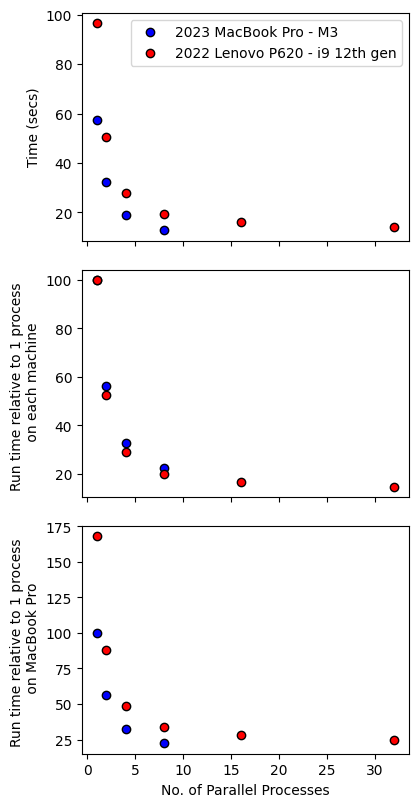

In [ ]:
f, a = plt.subplots(3,1, figsize = (4, 8), sharex = True)
f.tight_layout()
a[0].plot(c, t, 'ob', mec = 'k', label = "2023 MacBook Pro - M3")
a[0].plot(c, t_dask, 'ob', mec = 'k', label = "2023 MacBook Pro - M3 - Dask")
a[0].plot(c, t_P620, 'or', mec = 'k', label = "2022 Lenovo P620 - i9 12th gen")
a[0].set_ylabel('Time (secs)')
a[0].legend()

a[1].plot(c, 100*t/t[0], 'ob', mec = 'k', label = "2023 MacBook Pro - M3")
a[1].plot(c, 100*t_dask/t_dask[0], 'og', mec = 'k', label = "2023 MacBook Pro - M3 - Dask")
a[1].plot(c, 100*t_P620/t_P620[0], 'or', mec = 'k', label = "2022 Lenovo P620 - i9 12th gen")
a[1].set_ylabel('Run time relative to 1 process \n on each machine')

a[2].plot(c, 100*t/t[0], 'ob', mec = 'k', label = "2023 MacBook Pro - M3")
a[2].plot(c, 100*t_dask/t[0], 'ob', mec = 'k', label = "2023 MacBook Pro - M3 - Dask")
a[2].plot(c, 100*t_P620/t[0], 'or', mec = 'k', label = "2022 Lenovo P620 - i9 12th gen")
a[2].set_ylabel('Run time relative to 1 process \n on MacBook Pro')

a[2].set_xlabel('No. of Parallel Processes')

In [18]:
t

array([57.52482986, 32.30217004, 18.82504916, 12.82393169,         nan,
               nan])